I want to create a for loop code that generates cloropleth maps of the L Line stations in our study. But first, I need to know which census tracts falls within the walkshed. This requires taking a step back and first generating walkshed maps to identify which census tracts land within our walkshed. 

In [1]:
# Let's start by importing all of the libraries we'll need for our analyses

import pandas as pd

import geopandas as gpd

import contextily as ctx

import matplotlib.pyplot as plt

# for interactive plots
import plotly.express as px

# for network analysis
import networkx as nx

# for street network analysis
import osmnx as ox

/opt/conda/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


### East LA Civic Center

Bringing in the address and establishing the time criteria for the walkshed. 

In [80]:
# Let's start by orienting ourselves around the East LA Civic Center Station by calling for it by address in osmnx

address = 'East Los Angeles Civic Center, East 3rd Street, Belvedere Gardens, East Los Angeles, Los Angeles County, California, 90022-1601, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [81]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 2.57 s, sys: 23.6 ms, total: 2.59 s
Wall time: 2.6 s


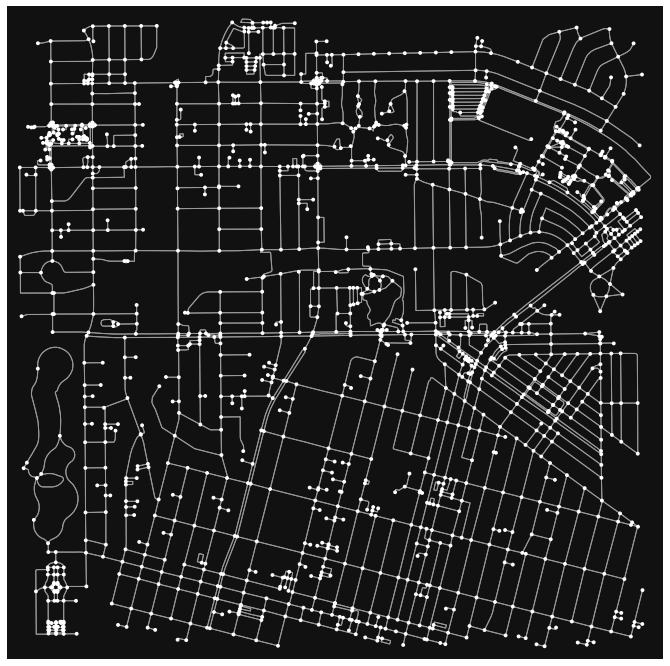

In [82]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [83]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [84]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [85]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
17445327,4.033839e+06,-1.315200e+07,traffic_signals,4,-118.146421,34.037501,POINT (-13151999.403 4033838.580)
8414804812,4.033816e+06,-1.315203e+07,NaN,3,-118.146684,34.037336,POINT (-13152028.735 4033816.401)
8414804800,4.033858e+06,-1.315197e+07,NaN,3,-118.146197,34.037648,POINT (-13151974.467 4033858.327)
3643016816,4.033796e+06,-1.315196e+07,NaN,4,-118.146107,34.037181,POINT (-13151964.459 4033795.566)
8414804799,4.033863e+06,-1.315202e+07,NaN,3,-118.146602,34.037683,POINT (-13152019.540 4033863.055)


<AxesSubplot:>

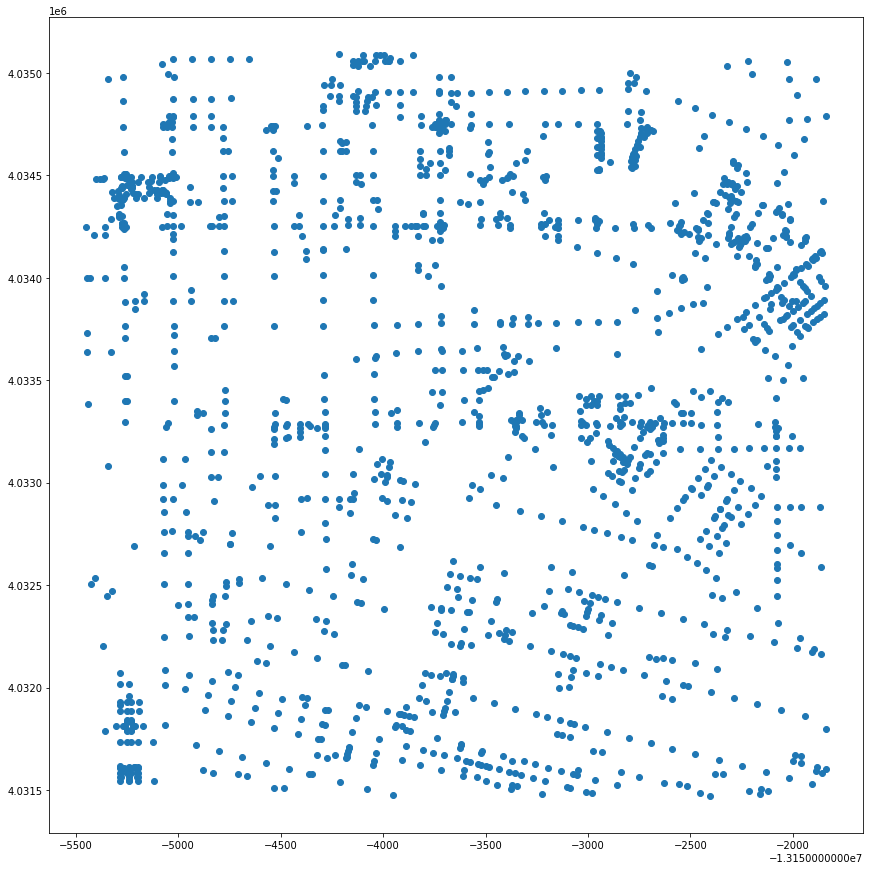

In [86]:
gdf_nodes.plot(figsize=(15,15))

In [87]:
gdf_edges.head()

osmid lanes                  name    highway  \
u          v          key                                                     
17445327   8414804812 0    397475166     7    Atlantic Boulevard    primary   
           8414804800 0    397479970     7    Atlantic Boulevard    primary   
           3643016816 0    397516716     5    West Reggin Street  secondary   
           8414804799 0    397516718     5  Avenida Cesar Chavez  secondary   
8414804812 4872874510 0    397475166     7    Atlantic Boulevard    primary   

                          maxspeed  oneway  length  \
u          v          key                            
17445327   8414804812 0     35 mph   False  30.439   
           8414804800 0     35 mph   False  26.329   
           3643016816 0        NaN   False  45.873   
           8414804799 0        NaN   False  26.236   
8414804812 4872874510 0     35 mph   False   5.754   

                                                                    geometry  \
u          v          key                                                      
17445327   8414804812 0    LINESTRING (-13151999.403 4033838.580, -131520...   
           8414804800 0    LINESTRING (-13151999.403 4033838.580, -131519...   
           3643016816 0    LINESTRING (-13151999.403 4033838.580, -131519...   
           8414804799 0    LINESTRING (-13151999.403 4033838.580, -131520...   
8414804812 4872874510 0    LINESTRING (-13152028.735 4033816.401, -131520...   

                          access service  ref bridge tunnel  
u          v          key                                    
17445327   8414804812 0      NaN     NaN  NaN    NaN    NaN  
           8414804800 0      NaN     NaN  NaN    NaN    NaN  
           3643016816 0      NaN     NaN  NaN    NaN    NaN  
           8414804799 0      NaN     NaN  NaN    NaN    NaN  
8414804812 4872874510 0      NaN     NaN  NaN    NaN    NaN

<AxesSubplot:>

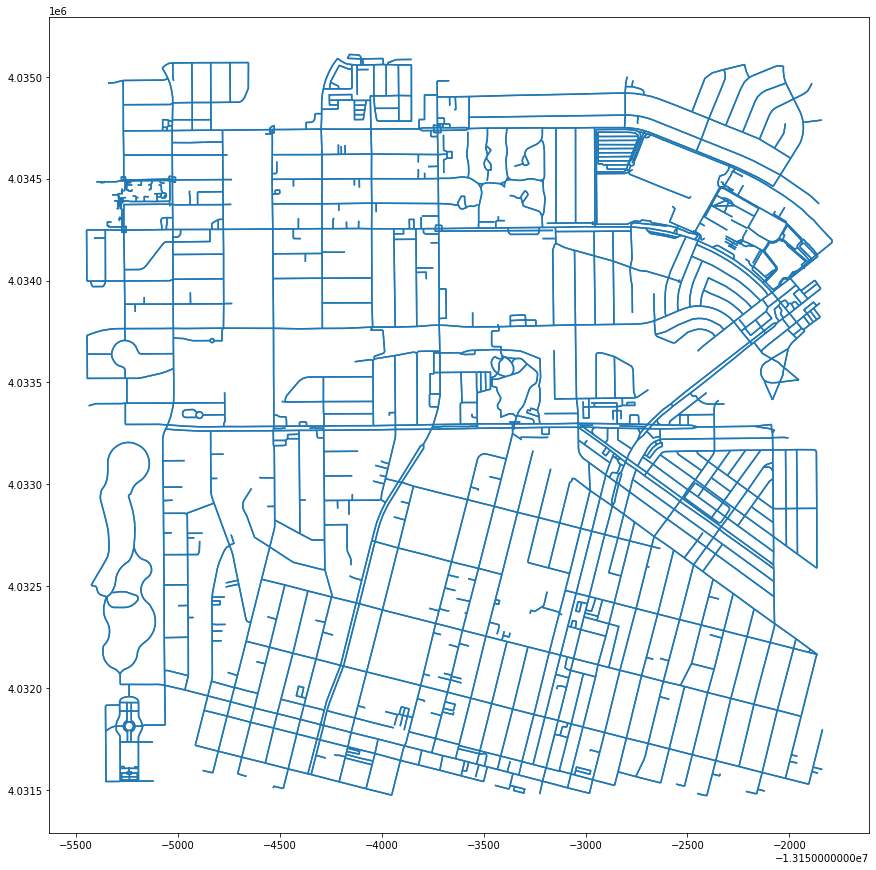

In [88]:
gdf_edges.plot(figsize=(15,15))

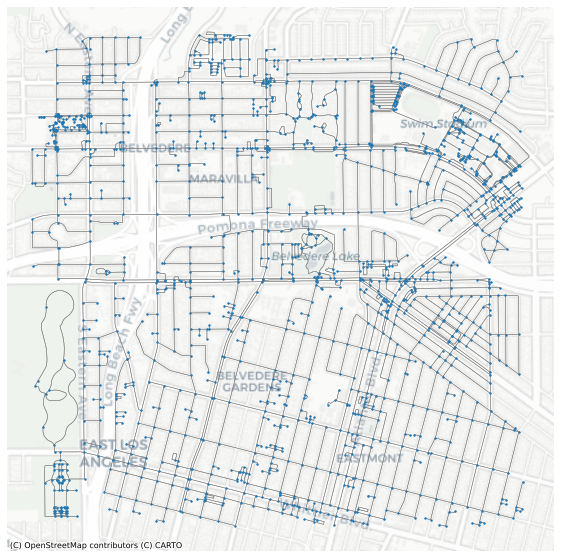

In [89]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)


# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [90]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13155448.347495379
4031471.857767747
-13151837.354721077
4035089.507649423


In [91]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13153642.851108227
4033280.6827085847


In [92]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node1 = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node1))

The id for the nearest node is 269612210


In [93]:
# what is this record?
gdf_nodes.loc[[center_node1]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
269612210,4.033295e+06,-1.315361e+07,NaN,3,-118.160921,34.033453,POINT (-13153613.569 4033294.845)


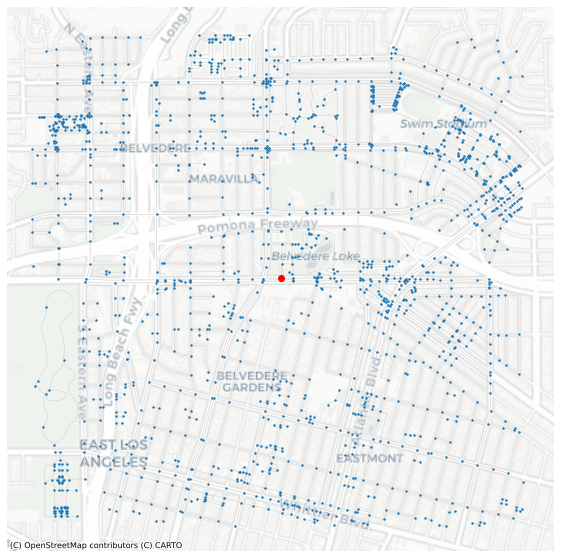

In [94]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gainsboro', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node1]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron, zoom=14)

In [19]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,maxspeed,oneway,length,geometry,access,service,ref,bridge,tunnel
u,v,key,,,,,,,,,,,,,
6502868347,6502868348,0,692658267,NaN,NaN,service,NaN,False,75.939,"LINESTRING (-13154838.228 4034789.092, -131549...",NaN,alley,NaN,NaN,NaN
8777112471,8777112476,0,948222706,NaN,NaN,footway,NaN,False,30.831,"LINESTRING (-13155131.888 4034471.825, -131551...",NaN,NaN,NaN,NaN,NaN
122555417,4605930417,0,162520758,NaN,Duncan Avenue,residential,NaN,False,146.106,"LINESTRING (-13154686.666 4031661.138, -131546...",NaN,NaN,NaN,NaN,NaN
123304220,1742549940,0,43751358,4,Whittier Boulevard,primary,25 mph,False,115.193,"LINESTRING (-13154150.429 4031782.272, -131542...",NaN,NaN,NaN,NaN,NaN
7639716692,123053542,0,397472577,5,Mednik Avenue,secondary,NaN,False,8.341,"LINESTRING (-13153726.291 4034726.111, -131537...",NaN,NaN,NaN,NaN,NaN


In [95]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [57]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,access,bridge,service,tunnel,width,walk_time
u,v,key,,,,,,,,,,,,,,
605181894,122935554,0,13464294,East 6th Street,residential,False,61.470,"LINESTRING (-13159831.586 4034015.339, -131597...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.768375
5544253261,5544253264,0,578702707,NaN,service,False,18.277,"LINESTRING (-13159853.983 4035341.698, -131598...",NaN,NaN,NaN,NaN,parking_aisle,NaN,NaN,0.228463
2481931291,2481931341,0,240456471,NaN,footway,False,37.588,"LINESTRING (-13159845.378 4034334.071, -131598...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.469850
269608438,122974131,0,13347781,South Fickett Street,residential,False,109.993,"LINESTRING (-13158774.151 4034525.159, -131588...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.374912
1997435526,4279710595,0,189097628,NaN,service,False,54.847,"LINESTRING (-13158583.115 4035411.280, -131586...",NaN,NaN,NaN,NaN,alley,NaN,NaN,0.685588


In [96]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [97]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [98]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 269612210, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 271 nodes within 10 minutes 


In [66]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
269607540,4.035191e+06,-1.316064e+07,traffic_signals,4,-118.224065,34.047568,POINT (-13160642.771 4035191.036),10 mins,#0d0887
3695966289,4.035295e+06,-1.315995e+07,NaN,1,-118.217885,34.048342,POINT (-13159954.794 4035295.091),10 mins,#0d0887
4409001095,4.036336e+06,-1.316183e+07,NaN,3,-118.234752,34.056093,POINT (-13161832.387 4036336.381),NaN,NaN
4984174722,4.036563e+06,-1.315876e+07,NaN,1,-118.207161,34.057782,POINT (-13158761.015 4036563.325),NaN,NaN
6479600249,4.034466e+06,-1.315952e+07,NaN,3,-118.213945,34.042174,POINT (-13159516.195 4034466.330),NaN,NaN
605181879,4.033628e+06,-1.315966e+07,NaN,3,-118.215281,34.035933,POINT (-13159664.885 4033628.012),NaN,NaN
9077188394,4.035407e+06,-1.316158e+07,crossing,4,-118.232511,34.049179,POINT (-13161582.897 4035407.424),NaN,NaN
5880367541,4.034220e+06,-1.315937e+07,NaN,3,-118.212651,34.040338,POINT (-13159372.159 4034219.761),NaN,NaN
122620415,4.033966e+06,-1.315874e+07,NaN,3,-118.206929,34.038447,POINT (-13158735.167 4033965.701),NaN,NaN


In [99]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [68]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
9407927227,4.034721e+06,-1.316172e+07,NaN,1,-118.233711,34.044067,POINT (-13161716.537 4034720.710),NaN,#cccccc
6817267581,4.035017e+06,-1.316075e+07,NaN,1,-118.224991,34.046275,POINT (-13160745.831 4035017.362),NaN,#cccccc
6731862532,4.033662e+06,-1.315894e+07,NaN,1,-118.208802,34.036185,POINT (-13158943.690 4033661.796),NaN,#cccccc
7882619496,4.036600e+06,-1.316158e+07,NaN,1,-118.232449,34.058052,POINT (-13161576.062 4036599.711),NaN,#cccccc
6790345568,4.036383e+06,-1.316027e+07,NaN,3,-118.220708,34.056436,POINT (-13160269.005 4036382.562),NaN,#cccccc


<AxesSubplot:>

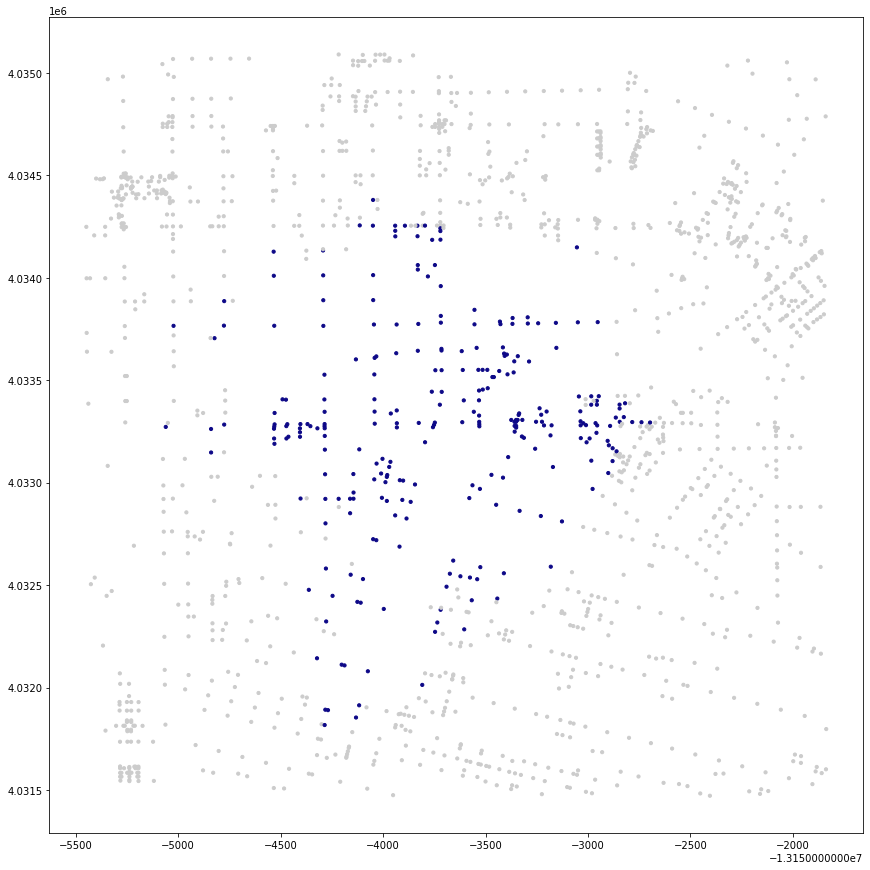

In [100]:
#plotting and taking a look at my nodes within the walkshed
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

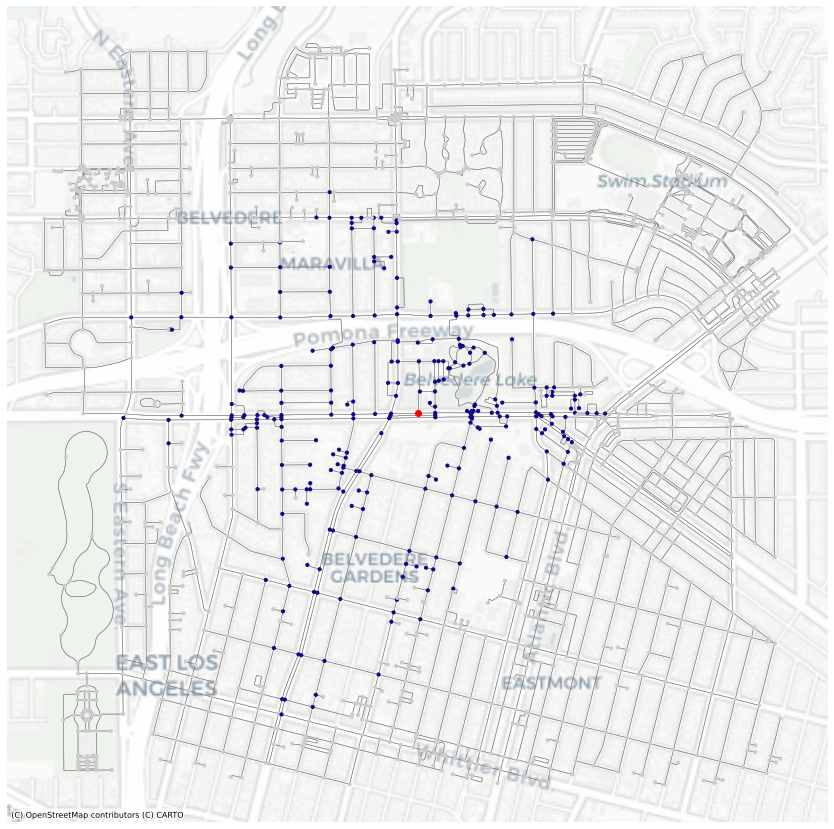

In [126]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[269612210]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [71]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
15713713,4.034584e+06,-1.316015e+07,traffic_signals,4,-118.219629,34.043049,POINT (-13160148.902 4034583.948),10 mins,#0d0887
604238292,4.034588e+06,-1.316008e+07,NaN,3,-118.219048,34.043076,POINT (-13160084.214 4034587.562),10 mins,#0d0887
72744268,4.034572e+06,-1.316038e+07,NaN,4,-118.221731,34.042958,POINT (-13160382.907 4034571.655),10 mins,#0d0887
604238295,4.034708e+06,-1.316016e+07,NaN,3,-118.219688,34.043976,POINT (-13160155.503 4034708.498),10 mins,#0d0887
123413088,4.034378e+06,-1.316014e+07,NaN,3,-118.219576,34.041517,POINT (-13160143.013 4034378.068),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
7875081594,4.035722e+06,-1.315982e+07,NaN,1,-118.216658,34.051518,POINT (-13159818.138 4035721.748),10 mins,#0d0887
8395946642,4.034758e+06,-1.315950e+07,NaN,1,-118.213780,34.044345,POINT (-13159497.750 4034757.991),10 mins,#0d0887
8395946644,4.034748e+06,-1.315946e+07,NaN,1,-118.213476,34.044269,POINT (-13159463.975 4034747.888),10 mins,#0d0887


In [102]:
#creating a new variable for 10 mins nodes
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

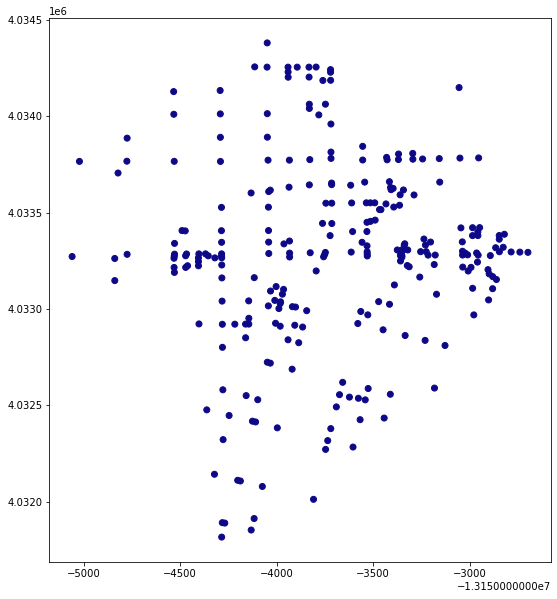

In [103]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

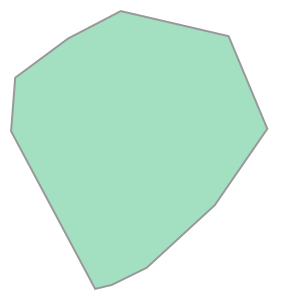

In [104]:
#creating our convex hull
gdf_10.unary_union.convex_hull

In [105]:
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13155060.722 4033271.808, -131550...",4.034241e+06,-1.315372e+07,traffic_signals,4,-118.161882,34.040497,#0d0887


In [106]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13154285.181 4031816.938, -13155060..."


In [107]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13154285.181 4031816.938, -13155060..."


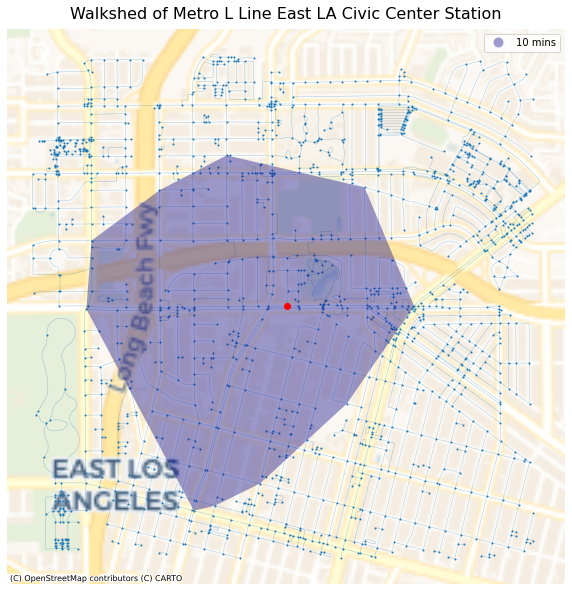

In [108]:
#plotting the convex hull on to the basemap

# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node1]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line East LA Civic Center Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=13)

### Mariachi Plaza Station

In [135]:
# Let's start by orienting ourselves around the Mariachi Plaza Station by calling for it by address in osmnx

address = 'Mariachi Plaza, Metro Gold Line Entrance, Brooklyn Heights, Boyle Heights, Los Angeles, Los Angeles County, California, 90033, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [136]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.4 s, sys: 34.6 ms, total: 3.44 s
Wall time: 3.45 s


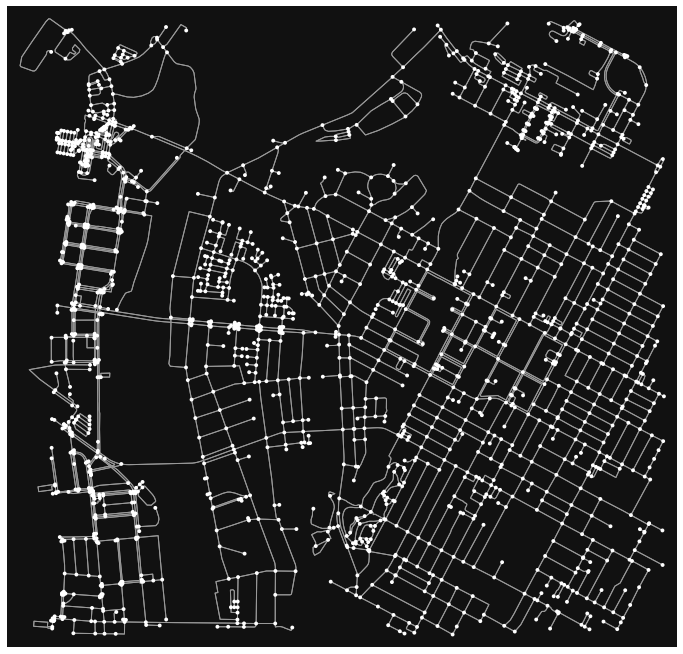

In [137]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [138]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [139]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [140]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
14941481,4.036783e+06,-1.315848e+07,stop,3,-118.204655,34.059417,POINT (-13158481.982 4036783.097)
8772109642,4.036793e+06,-1.315848e+07,crossing,4,-118.204605,34.059495,POINT (-13158476.416 4036793.498)
604238739,4.036724e+06,-1.315839e+07,NaN,4,-118.203870,34.058981,POINT (-13158394.652 4036724.445)
15373745,4.036812e+06,-1.315854e+07,NaN,3,-118.205136,34.059632,POINT (-13158535.560 4036812.014)
14941485,4.036619e+06,-1.315836e+07,NaN,3,-118.203524,34.058197,POINT (-13158356.146 4036619.141)


<AxesSubplot:>

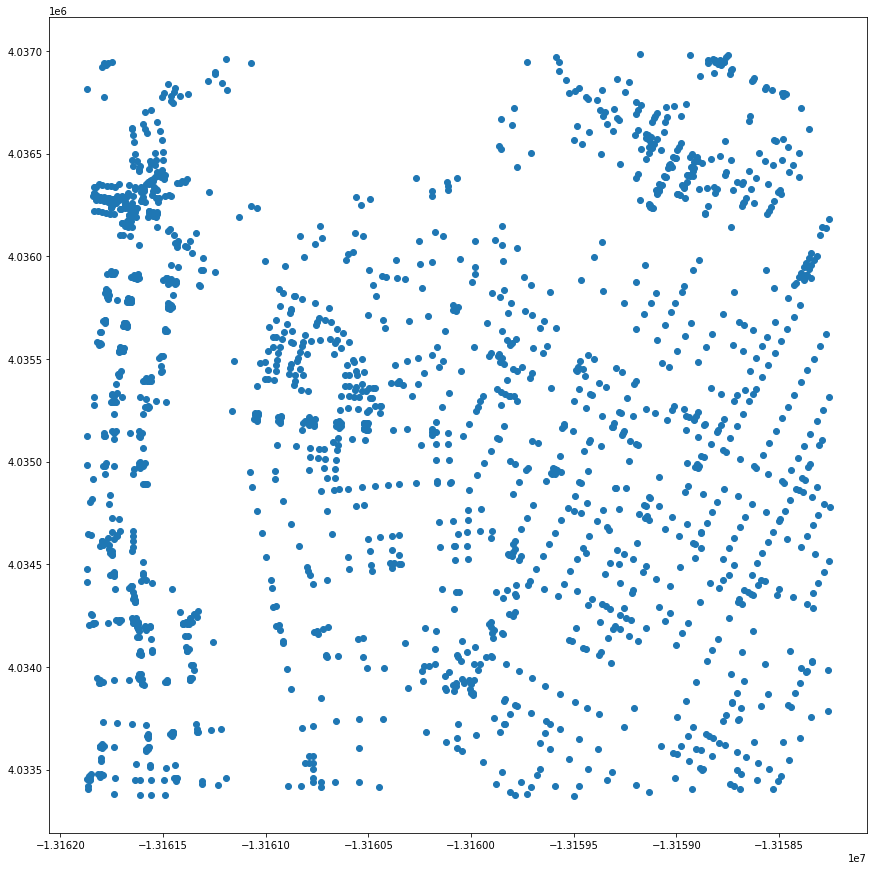

In [141]:
gdf_nodes.plot(figsize=(15,15))

In [142]:
gdf_edges.head()

osmid              name      highway  oneway  \
u          v          key                                                     
14941481   8772109642 0    161709222  San Pablo Street  residential   False   
           604238739  0    161709223      Zonal Avenue  residential   False   
           15373745   0    161709223      Zonal Avenue  residential   False   
8772109642 14941481   0    161709222  San Pablo Street  residential   False   
           8772216945 0    947706656               NaN      footway   False   

                           length  \
u          v          key           
14941481   8772109642 0     9.762   
           604238739  0    87.618   
           15373745   0    50.384   
8772109642 14941481   0     9.762   
           8772216945 0     9.079   

                                                                    geometry  \
u          v          key                                                      
14941481   8772109642 0    LINESTRING (-13158481.982 4036783.097, -131584...   
           604238739  0    LINESTRING (-13158481.982 4036783.097, -131584...   
           15373745   0    LINESTRING (-13158481.982 4036783.097, -131584...   
8772109642 14941481   0    LINESTRING (-13158476.416 4036793.498, -131584...   
           8772216945 0    LINESTRING (-13158476.416 4036793.498, -131584...   

                          lanes maxspeed access bridge service tunnel width  
u          v          key                                                    
14941481   8772109642 0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
           604238739  0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
           15373745   0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
8772109642 14941481   0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
           8772216945 0     NaN      NaN    NaN    NaN     NaN    NaN   NaN

<AxesSubplot:>

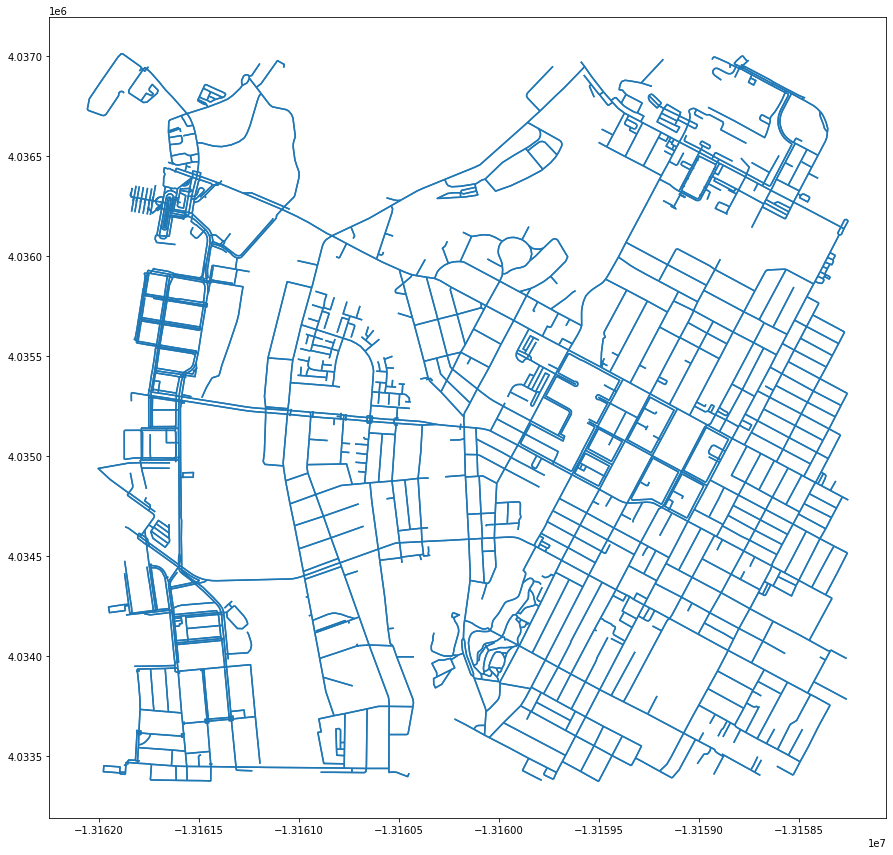

In [143]:
gdf_edges.plot(figsize=(15,15))

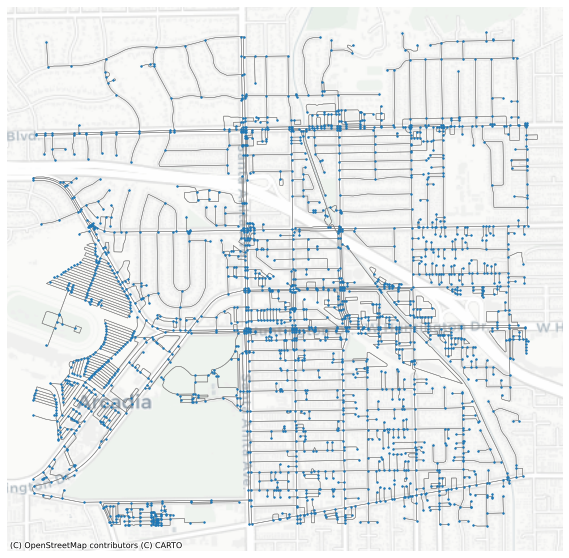

In [415]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)


# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [145]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13161872.984927278
4033373.0514499233
-13158251.594912536
4036983.296539621


In [146]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13160062.289919907
4035178.173994772


In [147]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node2 = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node2))

The id for the nearest node is 2935903748


In [148]:
# what is this record?
gdf_nodes.loc[[center_node2]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
2935903748,4.035186e+06,-1.316001e+07,NaN,3,-118.218374,34.047528,POINT (-13160009.241 4035185.662)


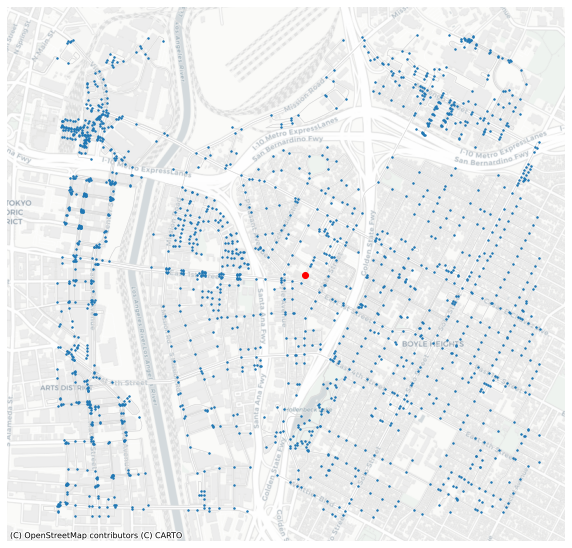

In [149]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gainsboro', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node2]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [150]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,access,bridge,service,tunnel,width
u,v,key,,,,,,,,,,,,,
123087199,7884363151,0,161716767,Mateo Street,secondary,False,39.487,"LINESTRING (-13161629.462 4034194.989, -131616...",2,25 mph,NaN,NaN,NaN,NaN,NaN
7849974595,7849974588,0,841330502,NaN,service,False,62.638,"LINESTRING (-13158952.707 4035224.503, -131589...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
9053800324,9053800320,0,"[978458962, 978458964]",NaN,footway,False,14.248,"LINESTRING (-13161798.468 4033607.486, -131617...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
123310162,123165996,0,13397485,North Breed Street,residential,False,235.721,"LINESTRING (-13158562.276 4035932.811, -131586...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
4020046724,122939359,0,38333792,Center Street,secondary,False,31.836,"LINESTRING (-13161445.997 4036101.837, -131614...",5,NaN,NaN,NaN,NaN,NaN,NaN


In [151]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [152]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,access,bridge,service,tunnel,width,walk_time
u,v,key,,,,,,,,,,,,,,
6315380216,6315380215,0,674348606,NaN,service,False,17.015,"LINESTRING (-13158653.058 4034363.425, -131586...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.212688
9484508114,123030030,0,711528835,NaN,service,False,15.057,"LINESTRING (-13158988.129 4036533.697, -131589...",2,NaN,NaN,NaN,driveway,NaN,NaN,0.188213
6808067013,6726238941,0,13397488,North Breed Street,residential,False,37.505,"LINESTRING (-13159155.609 4034788.689, -131591...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.468813
123461906,6731862529,0,13419763,Lanfranco Street,residential,False,19.747,"LINESTRING (-13158819.758 4033654.784, -131588...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.246837
9074503300,9432218824,0,981006136,NaN,footway,False,10.407,"LINESTRING (-13161809.132 4035576.012, -131618...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.130087


In [153]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [154]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [156]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 2935903748, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 287 nodes within 10 minutes 


In [157]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
122797937,4.033607e+06,-1.316055e+07,NaN,3,-118.223214,34.035779,POINT (-13160547.960 4033607.351),NaN,NaN
1836149468,4.035733e+06,-1.316007e+07,NaN,3,-118.218943,34.051602,POINT (-13160072.515 4035732.980),10 mins,#0d0887
9456154027,4.035555e+06,-1.316169e+07,NaN,3,-118.233497,34.050274,POINT (-13161692.636 4035554.595),NaN,NaN
4604376778,4.034579e+06,-1.315875e+07,NaN,4,-118.207021,34.043013,POINT (-13158745.386 4034579.084),NaN,NaN
123339302,4.033598e+06,-1.316157e+07,NaN,3,-118.232421,34.035713,POINT (-13161572.868 4033598.458),NaN,NaN
7882619526,4.036792e+06,-1.316138e+07,NaN,3,-118.230681,34.059484,POINT (-13161379.250 4036792.100),NaN,NaN
122647421,4.033600e+06,-1.315938e+07,NaN,3,-118.212735,34.035723,POINT (-13159381.465 4033599.788),NaN,NaN
4749829586,4.035176e+06,-1.316076e+07,NaN,1,-118.225158,34.047456,POINT (-13160764.354 4035175.975),NaN,NaN
123119553,4.033716e+06,-1.316158e+07,NaN,3,-118.232526,34.036585,POINT (-13161584.623 4033715.516),NaN,NaN


In [158]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [159]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
605023318,4.035594e+06,-1.316065e+07,NaN,3,-118.224153,34.050568,POINT (-13160652.489 4035594.150),NaN,#cccccc
8474075899,4.033801e+06,-1.315869e+07,NaN,1,-118.206495,34.037218,POINT (-13158686.865 4033800.643),NaN,#cccccc
4279710599,4.035033e+06,-1.315858e+07,NaN,4,-118.205516,34.046393,POINT (-13158577.883 4035033.162),NaN,#cccccc
6735433781,4.034224e+06,-1.315905e+07,NaN,1,-118.209796,34.040373,POINT (-13159054.331 4034224.382),NaN,#cccccc
604238599,4.036532e+06,-1.315846e+07,NaN,3,-118.204437,34.057552,POINT (-13158457.770 4036532.447),NaN,#cccccc


<AxesSubplot:>

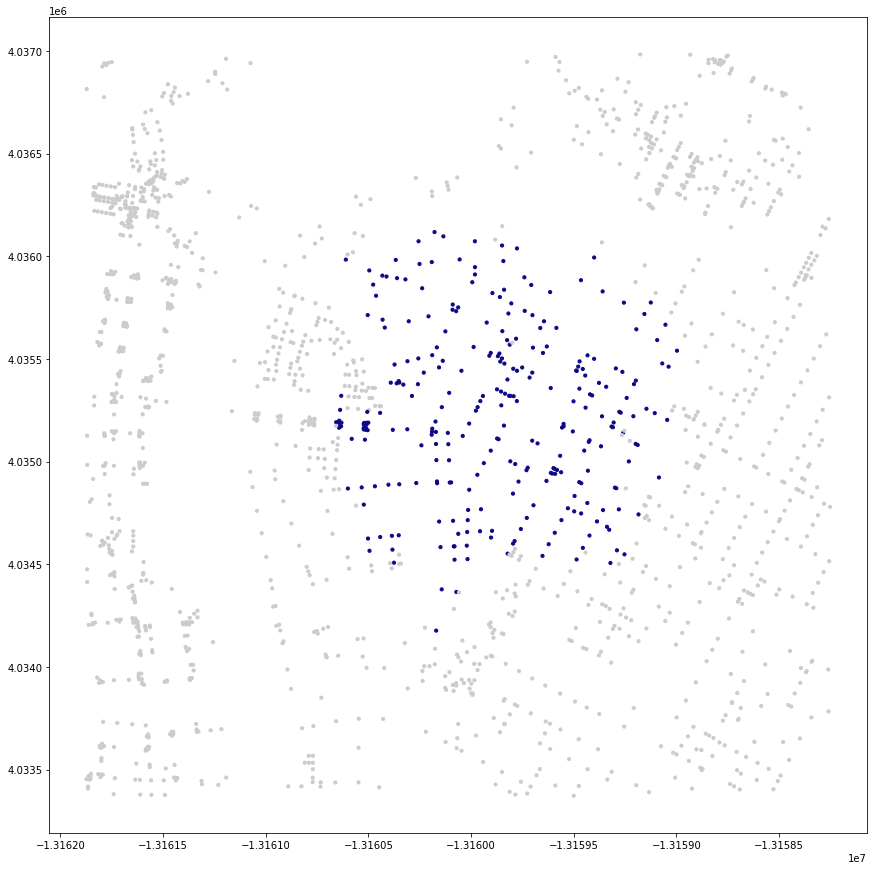

In [160]:
#plotting and taking a look at my nodes within the walkshed
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

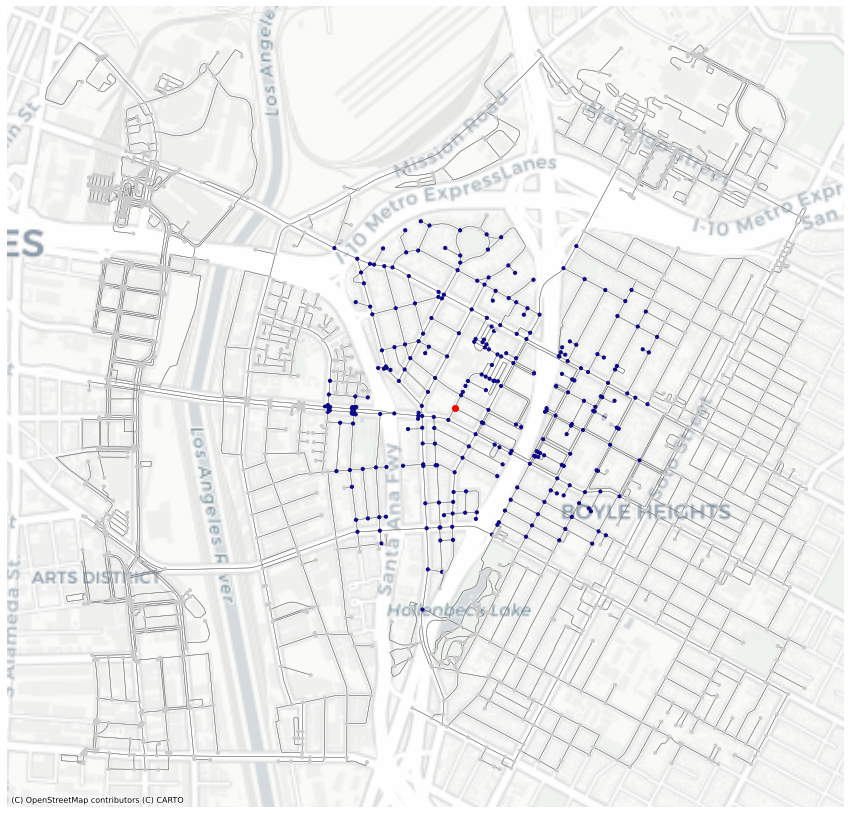

In [161]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[2935903748]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [162]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
15713713,4.034584e+06,-1.316015e+07,traffic_signals,4,-118.219629,34.043049,POINT (-13160148.902 4034583.948),10 mins,#0d0887
604238292,4.034588e+06,-1.316008e+07,NaN,3,-118.219048,34.043076,POINT (-13160084.214 4034587.562),10 mins,#0d0887
72744268,4.034572e+06,-1.316038e+07,NaN,4,-118.221731,34.042958,POINT (-13160382.907 4034571.655),10 mins,#0d0887
604238295,4.034708e+06,-1.316016e+07,NaN,3,-118.219688,34.043976,POINT (-13160155.503 4034708.498),10 mins,#0d0887
123413088,4.034378e+06,-1.316014e+07,NaN,3,-118.219576,34.041517,POINT (-13160143.013 4034378.068),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
7875081594,4.035722e+06,-1.315982e+07,NaN,1,-118.216658,34.051518,POINT (-13159818.138 4035721.748),10 mins,#0d0887
8395946642,4.034758e+06,-1.315950e+07,NaN,1,-118.213780,34.044345,POINT (-13159497.750 4034757.991),10 mins,#0d0887
8395946644,4.034748e+06,-1.315946e+07,NaN,1,-118.213476,34.044269,POINT (-13159463.975 4034747.888),10 mins,#0d0887


In [163]:
#creating a new variable for 10 mins nodes
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

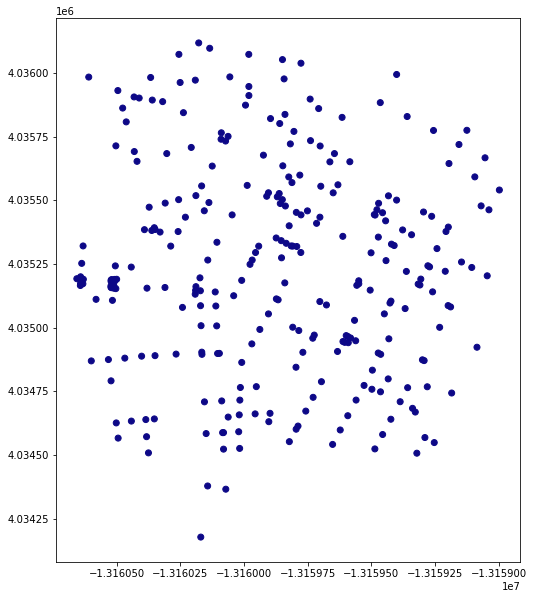

In [164]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

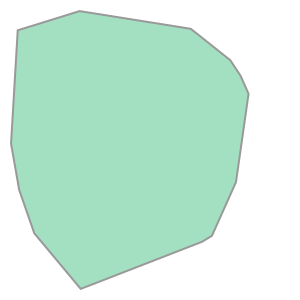

In [165]:
#creating our convex hull
gdf_10.unary_union.convex_hull

In [166]:
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13160656.853 4035192.232, -131606...",4.034584e+06,-1.316015e+07,traffic_signals,4,-118.219629,34.043049,#0d0887


In [167]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13160169.964 4034177.270, -13160494..."


In [168]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13160169.964 4034177.270, -13160494..."


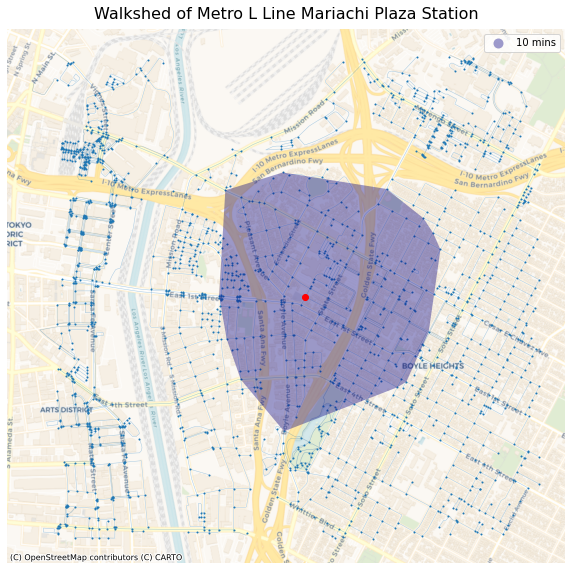

In [169]:
#plotting the convex hull on to the basemap

# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node2]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Mariachi Plaza Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

### Chinatown Station

In [170]:
address = 'Chinatown Station, College Street, New Chinatown, Chinatown, Los Angeles, Los Angeles County, California, 90012, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [171]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 4.5 s, sys: 52.1 ms, total: 4.55 s
Wall time: 4.67 s


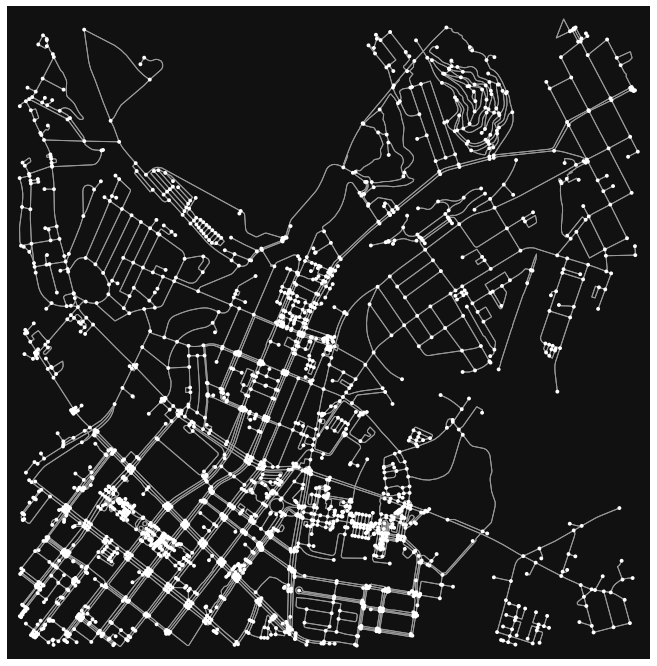

In [172]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [173]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [174]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [175]:
gdf_nodes.head()

,y,x,street_count,lon,lat,highway,geometry
osmid,,,,,,,
15027548,4.039027e+06,-1.316061e+07,3,-118.223785,34.076114,NaN,POINT (-13160611.557 4039026.875)
67619407,4.039118e+06,-1.316050e+07,4,-118.222746,34.076796,traffic_signals,POINT (-13160495.907 4039118.493)
123283621,4.038908e+06,-1.316055e+07,3,-118.223245,34.075226,NaN,POINT (-13160551.456 4038907.559)
15027549,4.038710e+06,-1.316045e+07,4,-118.222311,34.073758,traffic_signals,POINT (-13160447.416 4038710.296)
3723806094,4.038716e+06,-1.316045e+07,4,-118.222338,34.073802,NaN,POINT (-13160450.467 4038716.075)


### Plotting the station area

<AxesSubplot:>

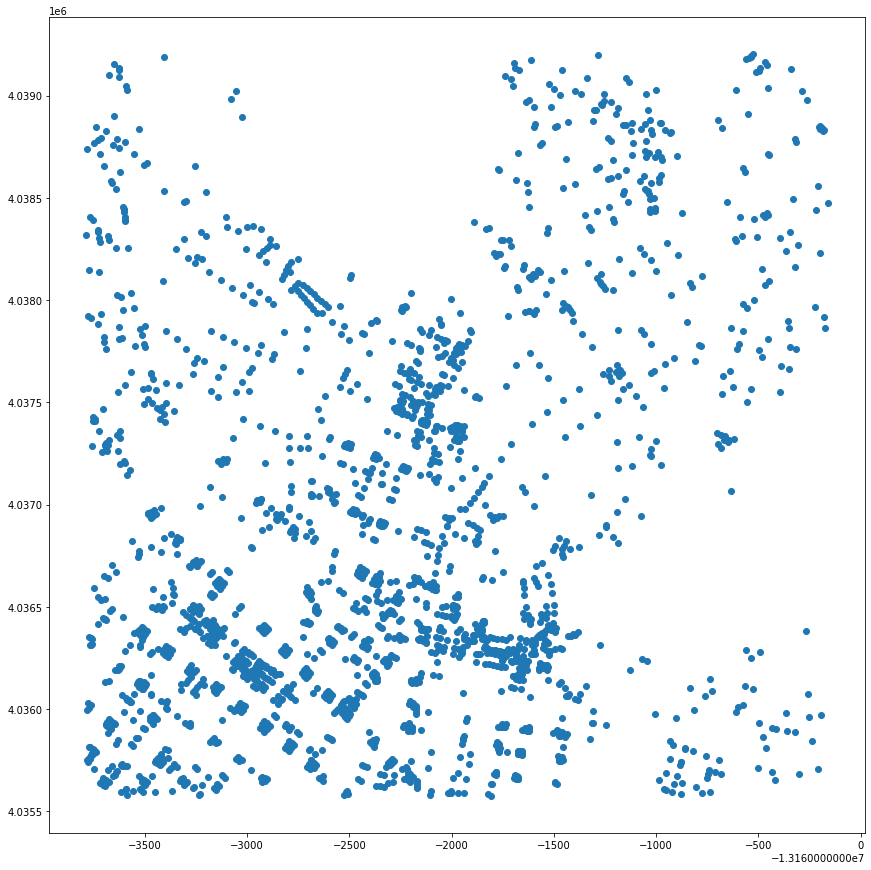

In [176]:
gdf_nodes.plot(figsize=(15,15))

In [177]:
gdf_edges.head()

osmid               name    highway  oneway  \
u        v          key                                                    
15027548 67619407   0      9126419    Humboldt Street   tertiary   False   
         123283621  0    358037415          Avenue 19   tertiary   False   
67619407 7871476832 0      9126419    Humboldt Street   tertiary   False   
         6787624912 0    398398790  San Fernando Road  secondary   False   
         15027548   0      9126419    Humboldt Street   tertiary   False   

                          length  \
u        v          key            
15027548 67619407   0    122.072   
         123283621  0    110.537   
67619407 7871476832 0     41.864   
         6787624912 0     67.319   
         15027548   0    122.072   

                                                                  geometry  \
u        v          key                                                      
15027548 67619407   0    LINESTRING (-13160611.557 4039026.875, -131605...   
         123283621  0    LINESTRING (-13160611.557 4039026.875, -131606...   
67619407 7871476832 0    LINESTRING (-13160495.907 4039118.493, -131604...   
         6787624912 0    LINESTRING (-13160495.907 4039118.493, -131605...   
         15027548   0    LINESTRING (-13160495.907 4039118.493, -131605...   

                        lanes maxspeed bridge service access tunnel width  
u        v          key                                                    
15027548 67619407   0     NaN      NaN    NaN     NaN    NaN    NaN   NaN  
         123283621  0       2      NaN    NaN     NaN    NaN    NaN   NaN  
67619407 7871476832 0     NaN      NaN    NaN     NaN    NaN    NaN   NaN  
         6787624912 0       4      NaN    NaN     NaN    NaN    NaN   NaN  
         15027548   0     NaN      NaN    NaN     NaN    NaN    NaN   NaN

<AxesSubplot:>

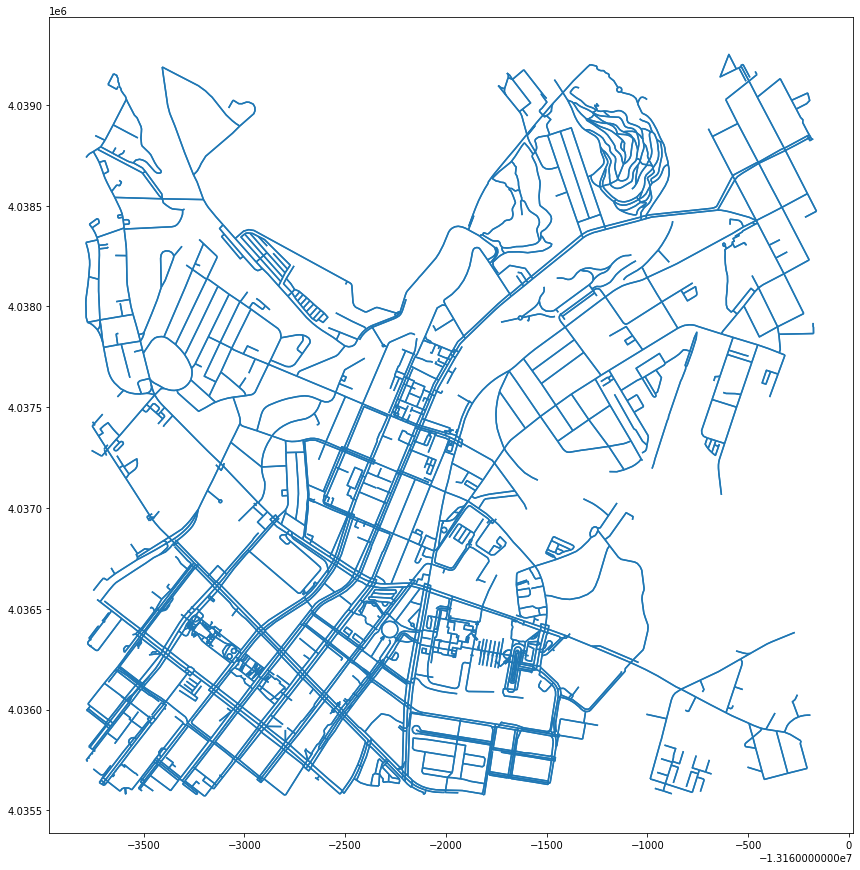

In [178]:
gdf_edges.plot(figsize=(15,15))

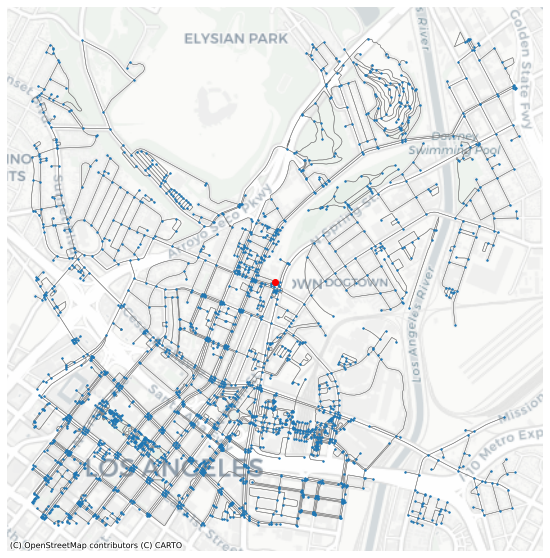

In [179]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[8290553634]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [180]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,bridge,service,access,tunnel,width
u,v,key,,,,,,,,,,,,,
755194296,7691650267,0,517788547,Bellevue Avenue,tertiary,False,20.699,"LINESTRING (-13163485.570 4037569.120, -131635...",4,NaN,NaN,NaN,NaN,NaN,NaN
6699521860,2158444968,0,381459559,South Grand Avenue,primary,False,10.846,"LINESTRING (-13163685.389 4035917.884, -131636...",2,NaN,NaN,NaN,NaN,NaN,NaN
8290762666,6477068300,0,259864031,NaN,steps,False,8.801,"LINESTRING (-13162608.284 4037082.477, -131625...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
8397761156,3297564574,0,161687523,South Hill Street,secondary,False,12.835,"LINESTRING (-13163515.515 4035640.999, -131635...",3,NaN,NaN,NaN,NaN,NaN,NaN
7222233401,8873363307,0,"[24716419, 399312996]",North Grand Avenue,primary,False,50.711,"LINESTRING (-13163087.225 4036672.055, -131630...","[6, 4]",NaN,NaN,NaN,NaN,NaN,NaN


In [181]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [182]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,bridge,service,access,tunnel,width,walk_time
u,v,key,,,,,,,,,,,,,,
1593912352,2094664086,0,146104135,Park Row Drive East,unclassified,False,15.607,"LINESTRING (-13161233.120 4038791.079, -131612...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.195087
6883792544,8409457190,0,398807762,North Broadway,secondary,False,18.813,"LINESTRING (-13161965.837 4037755.196, -131619...",5,NaN,NaN,NaN,NaN,NaN,NaN,0.235162
1967647044,2247672431,0,186070558,NaN,service,False,379.370,"LINESTRING (-13161529.052 4038350.130, -131615...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.742125
9074390822,9074390819,0,980991440,NaN,footway,False,3.230,"LINESTRING (-13161662.680 4035792.568, -131616...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.040375
1378070871,9060857343,0,821669123,NaN,footway,False,124.105,"LINESTRING (-13162151.762 4036175.857, -131621...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.551313


In [183]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [184]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [185]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 8290553634, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 173 nodes within 10 minutes 


In [186]:
gdf_nodes.sample(30)

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
6731343123,4.037866e+06,-1.316018e+07,3,-118.219871,34.067474,NaN,POINT (-13160175.797 4037865.725),NaN,NaN
8873772423,4.036312e+06,-1.316315e+07,1,-118.246631,34.055915,NaN,POINT (-13163154.740 4036312.491),NaN,NaN
605023348,4.035700e+06,-1.316074e+07,3,-118.224961,34.051354,NaN,POINT (-13160742.491 4035699.713),NaN,NaN
6787477768,4.036575e+06,-1.316226e+07,3,-118.238580,34.057866,NaN,POINT (-13162258.551 4036574.611),NaN,NaN
2158524680,4.036024e+06,-1.316254e+07,3,-118.241084,34.053765,NaN,POINT (-13162537.295 4036023.652),NaN,NaN
4409000758,4.036304e+06,-1.316195e+07,3,-118.235767,34.055852,NaN,POINT (-13161945.387 4036304.053),NaN,NaN
9448316139,4.036209e+06,-1.316232e+07,3,-118.239098,34.055147,NaN,POINT (-13162316.137 4036209.273),NaN,NaN
2382739509,4.039133e+06,-1.316363e+07,3,-118.250878,34.076903,NaN,POINT (-13163627.480 4039132.900),NaN,NaN
2158444967,4.035917e+06,-1.316366e+07,3,-118.251214,34.052968,traffic_signals,POINT (-13163664.884 4035916.608),NaN,NaN


In [187]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [188]:
gdf_nodes.sample(5)

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
605023298,4.035593e+06,-1.316074e+07,1,-118.224914,34.050557,NaN,POINT (-13160737.181 4035592.591),NaN,#cccccc
9074431218,4.035767e+06,-1.316147e+07,3,-118.231526,34.051857,crossing,POINT (-13161473.226 4035767.349),NaN,#cccccc
7874911454,4.035588e+06,-1.316197e+07,3,-118.235981,34.050522,NaN,POINT (-13161969.198 4035587.848),NaN,#cccccc
8409457198,4.037742e+06,-1.316203e+07,1,-118.236556,34.066557,NaN,POINT (-13162033.240 4037742.483),10 mins,#0d0887
7672084071,4.035854e+06,-1.316259e+07,4,-118.241574,34.052499,NaN,POINT (-13162591.775 4035853.539),NaN,#cccccc


<AxesSubplot:>

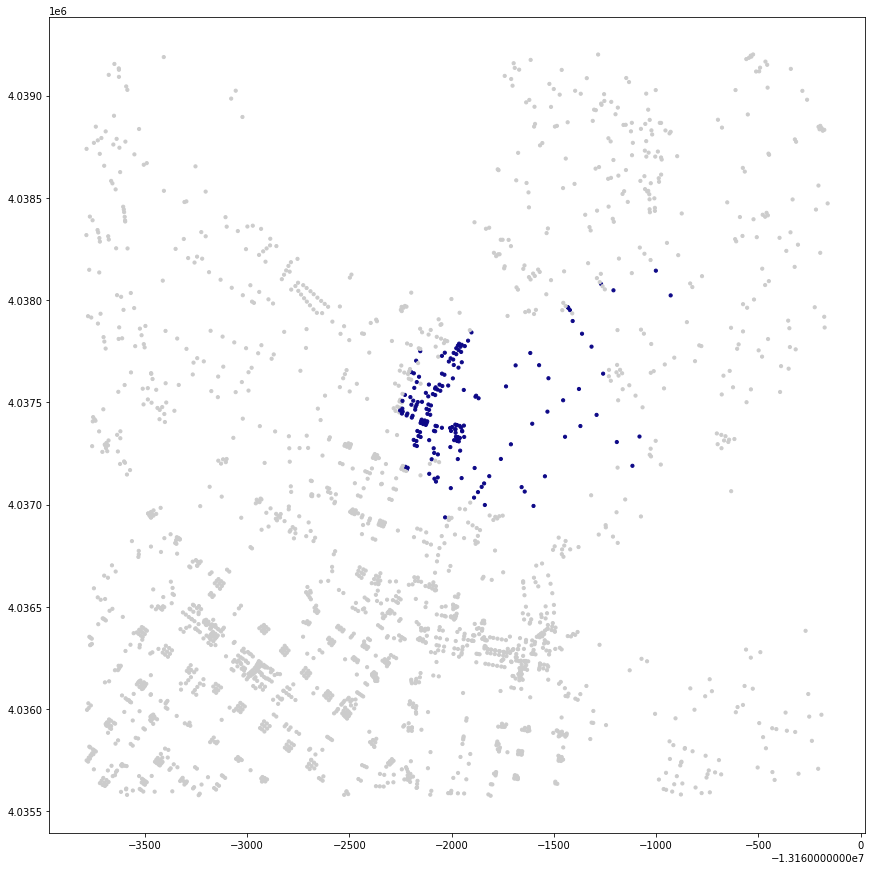

In [189]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

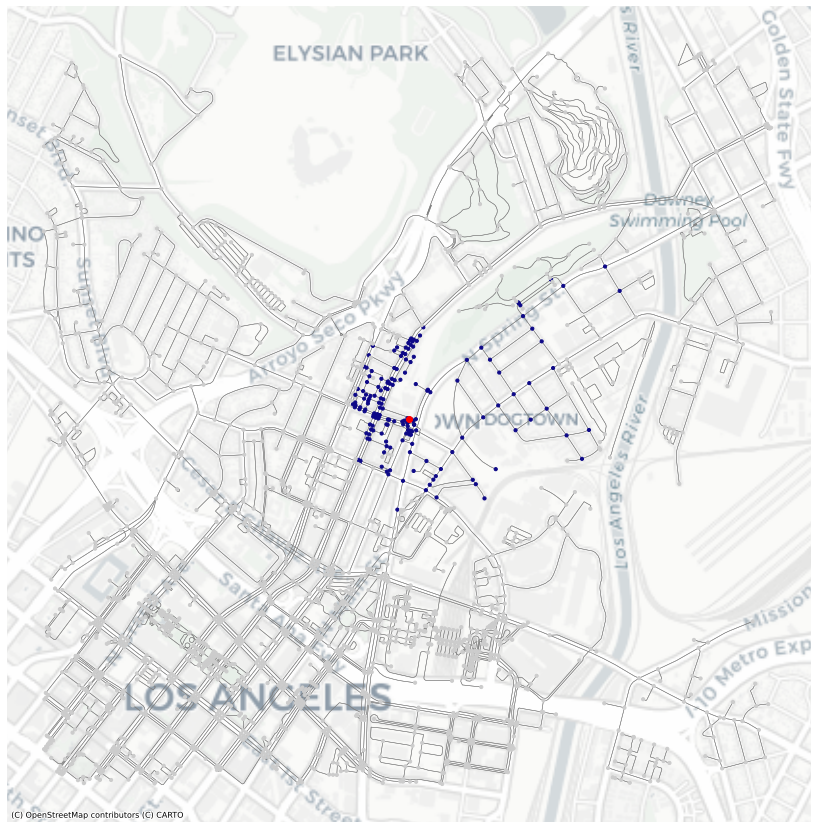

In [190]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[8290553634]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [191]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
15717265,4.038144e+06,-1.316100e+07,4,-118.227285,34.069542,traffic_signals,POINT (-13161001.164 4038143.644),10 mins,#0d0887
122656713,4.038023e+06,-1.316093e+07,4,-118.226635,34.068642,NaN,POINT (-13160928.751 4038022.752),10 mins,#0d0887
123037729,4.038048e+06,-1.316121e+07,4,-118.229147,34.068827,NaN,POINT (-13161208.430 4038047.599),10 mins,#0d0887
17677673,4.037351e+06,-1.316198e+07,3,-118.236082,34.063645,NaN,POINT (-13161980.397 4037351.213),10 mins,#0d0887
67619377,4.037281e+06,-1.316201e+07,3,-118.236313,34.063122,NaN,POINT (-13162006.145 4037280.975),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8409454505,4.037529e+06,-1.316211e+07,1,-118.237282,34.064967,NaN,POINT (-13162114.070 4037528.873),10 mins,#0d0887
8409457169,4.037488e+06,-1.316217e+07,3,-118.237797,34.064661,NaN,POINT (-13162171.299 4037487.673),10 mins,#0d0887
8409457171,4.037477e+06,-1.316218e+07,1,-118.237841,34.064580,NaN,POINT (-13162176.286 4037476.802),10 mins,#0d0887


In [192]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

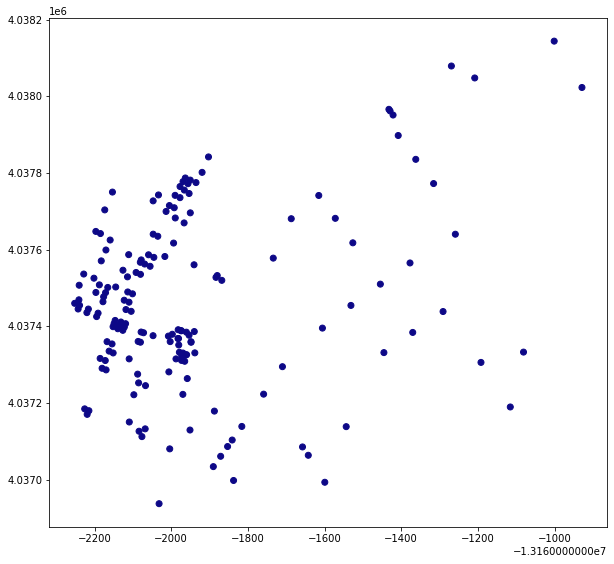

In [193]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

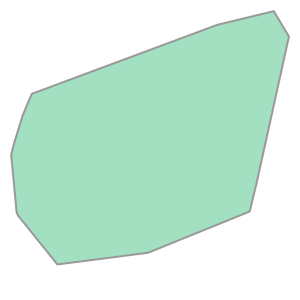

In [194]:
gdf_10.unary_union.convex_hull

There's our polygon! At first we thought it was odd that these haven't been asymettrical shapes. But now we've realized that 10 minutes allows you to reach only certain distances based on how directly connected the route is. For instance, walking down one straight road for ten minutes will allow someone to cover for more geographical ground. But having to zig-zag through a network of grided streets to get to a point, is going to result in covering less geographical ground in 10 minutes


In [195]:
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,street_count,lon,lat,highway,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13162251.772 4037459.803, -131622...",4.038144e+06,-1.316100e+07,4,-118.227285,34.069542,traffic_signals,#0d0887


In [196]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13162031.671 4036937.288, -13162219..."


In [197]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13162031.671 4036937.288, -13162219..."


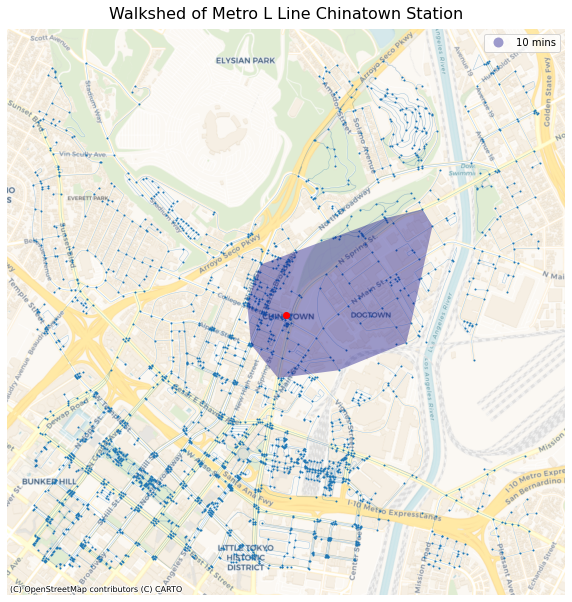

In [198]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[8290553634]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Chinatown Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

### Heritage Square Station

In [199]:
address = 'Heritage Square, Marmion Way, Dayton Avenue, Los Angeles, Los Angeles County, California, 90031-2212, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [200]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.49 s, sys: 25.2 ms, total: 3.52 s
Wall time: 13.7 s


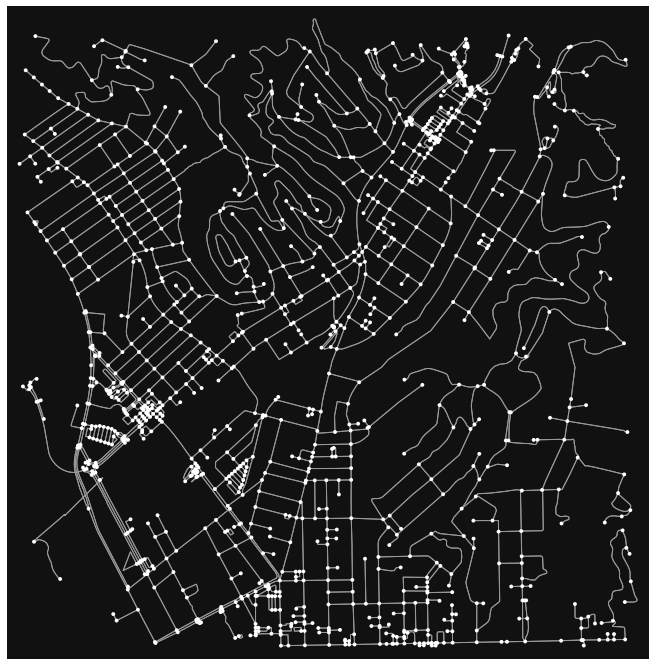

In [201]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [202]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [203]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [204]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
10559930,4.040461e+06,-1.316083e+07,traffic_signals,3,-118.225778,34.086785,POINT (-13160833.383 4040461.066)
6872663520,4.040451e+06,-1.316082e+07,NaN,4,-118.225648,34.086711,POINT (-13160818.979 4040451.213)
2156883458,4.040355e+06,-1.316083e+07,NaN,3,-118.225738,34.085997,POINT (-13160828.975 4040355.176)
18660349,4.040552e+06,-1.316084e+07,NaN,3,-118.225864,34.087459,POINT (-13160843.001 4040551.674)
14695503,4.040667e+06,-1.316087e+07,NaN,3,-118.226097,34.088318,POINT (-13160868.883 4040667.177)


### Plotting the station area

<AxesSubplot:>

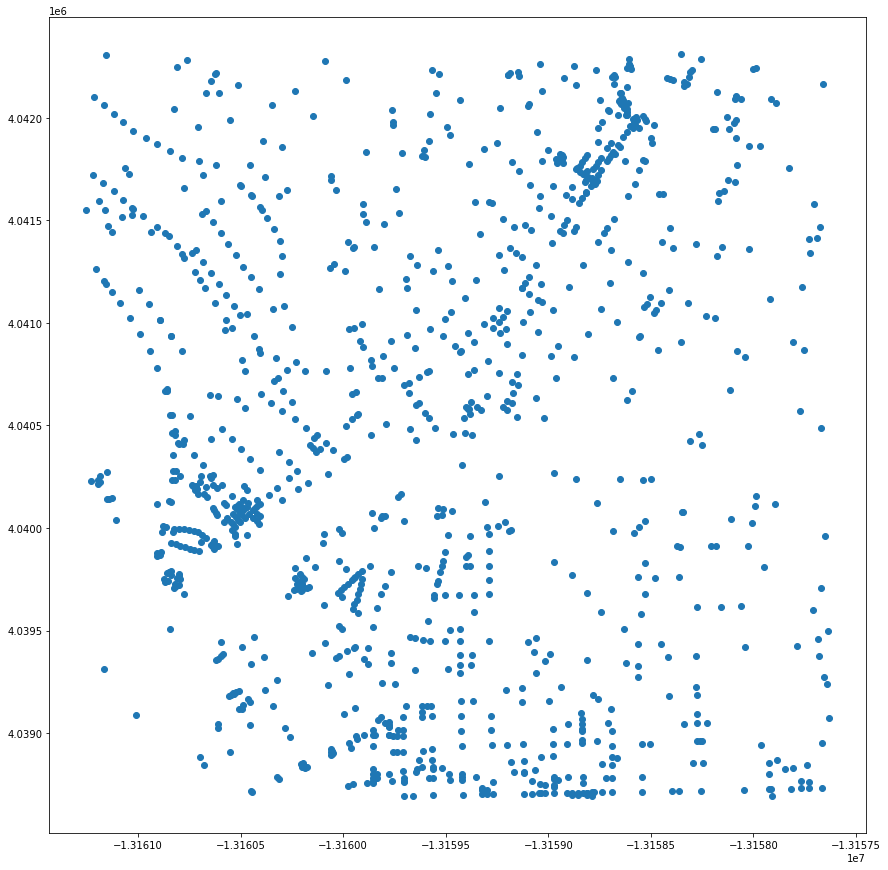

In [205]:
gdf_nodes.plot(figsize=(15,15))

In [206]:
gdf_edges.head()

osmid lanes               name    highway  \
u          v          key                                                  
10559930   6872663520 0    398375445     5     West Avenue 26    primary   
           2156883458 0    104359364   NaN  San Fernando Road  secondary   
           18660349   0    398374225     5  San Fernando Road    primary   
6872663520 10559930   0    398375445     5     West Avenue 26    primary   
           2156883447 0    398375445     5     West Avenue 26    primary   

                           oneway  length  \
u          v          key                   
10559930   6872663520 0     False  14.437   
           2156883458 0     False  87.691   
           18660349   0     False  75.390   
6872663520 10559930   0     False  14.437   
           2156883447 0     False  46.393   

                                                                    geometry  \
u          v          key                                                      
10559930   6872663520 0    LINESTRING (-13160833.383 4040461.066, -131608...   
           2156883458 0    LINESTRING (-13160833.383 4040461.066, -131608...   
           18660349   0    LINESTRING (-13160833.383 4040461.066, -131608...   
6872663520 10559930   0    LINESTRING (-13160818.979 4040451.213, -131608...   
           2156883447 0    LINESTRING (-13160818.979 4040451.213, -131607...   

                          access service maxspeed bridge width tunnel junction  
u          v          key                                                       
10559930   6872663520 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           2156883458 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           18660349   0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
6872663520 10559930   0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           2156883447 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN

<AxesSubplot:>

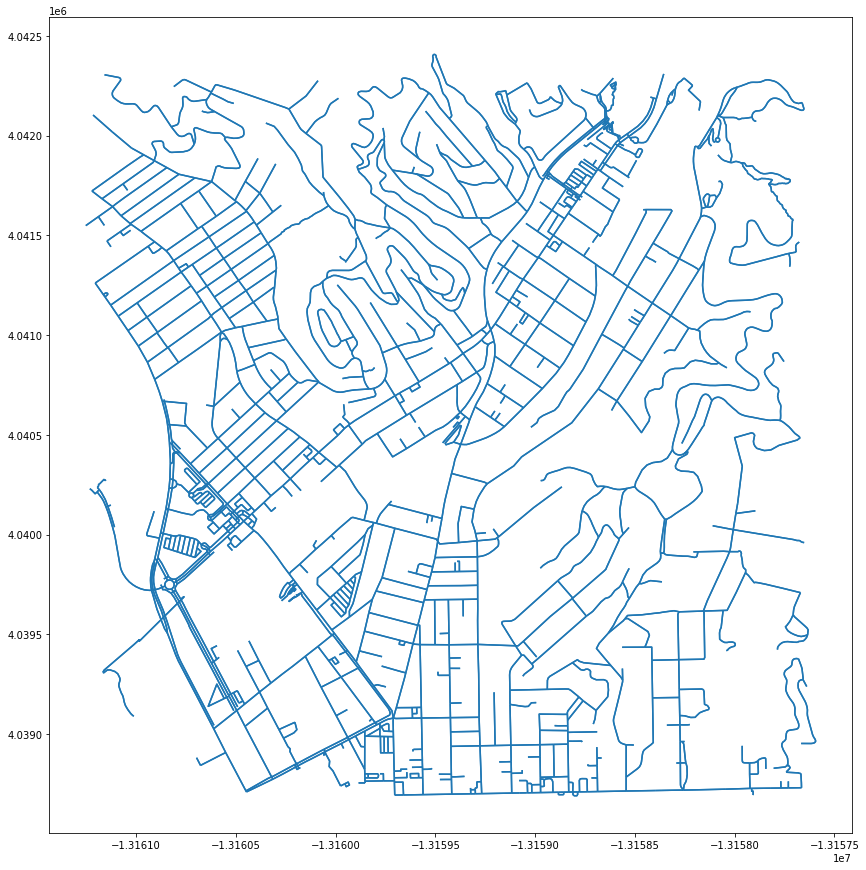

In [207]:
gdf_edges.plot(figsize=(15,15))

In [208]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13161252.734988471
4038694.329905593
-13157631.255918141
4042309.5162158757


In [209]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13159441.995453306
4040501.9230607343


In [211]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node3 = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node3))

The id for the nearest node is 1995905139


In [212]:
# what is this record?
gdf_nodes.loc[[center_node3]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
1995905139,4.040537e+06,-1.315941e+07,NaN,1,-118.213003,34.087353,POINT (-13159411.288 4040537.413)


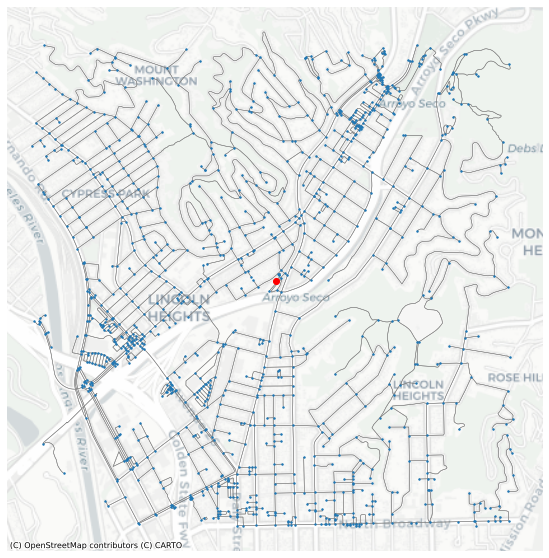

In [213]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node3]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [218]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,access,service,maxspeed,bridge,width,tunnel,junction
u,v,key,,,,,,,,,,,,,,
17585657,2217479282,0,211792207,NaN,NaN,service,False,24.853,"LINESTRING (-13160211.152 4039774.074, -131602...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
5555657488,5555657477,0,"[398414384, 398415111]","[5, 4]",N Figueroa Street,secondary,False,38.994,"LINESTRING (-13158636.126 4041906.084, -131586...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
7082081808,8411498391,0,"[758335363, 398371092]","[5, 4]",West Avenue 26,primary,False,15.715,"LINESTRING (-13160509.410 4040117.713, -131605...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
26468595,21687745,0,55545933,NaN,Avenue 43,residential,False,92.582,"LINESTRING (-13158320.246 4041098.161, -131584...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
1614923653,279072574,0,"[398364836, 398364837, 32504692, 32504693, 154...","[5, 4]","[West Avenue 26, Avenue 26]",primary,False,232.732,"LINESTRING (-13160409.768 4040020.777, -131603...",NaN,NaN,NaN,yes,NaN,NaN,NaN


In [219]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [220]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,access,service,maxspeed,bridge,width,tunnel,junction,walk_time
u,v,key,,,,,,,,,,,,,,,
6927746478,6927746480,0,739869848,NaN,NaN,service,False,23.148,"LINESTRING (-13159953.670 4039604.067, -131599...",no,parking_aisle,NaN,NaN,NaN,NaN,NaN,0.289350
1874531402,1669488434,0,"[398372313, 398372317]","[6, 4]",Cypress Avenue,tertiary,False,53.327,"LINESTRING (-13160354.275 4040611.569, -131603...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.666587
7082081811,14697104,0,398371092,5,West Avenue 26,primary,False,28.247,"LINESTRING (-13160485.232 4040091.933, -131604...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.353087
1669488806,1669445555,0,154410782,NaN,West Avenue 37,residential,False,46.258,"LINESTRING (-13159672.700 4041328.681, -131596...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.578225
4603976907,1842111286,0,173383998,NaN,Pomona Street,residential,False,93.684,"LINESTRING (-13158450.745 4039435.823, -131585...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.171050


In [221]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [222]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [223]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, center_node3, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 142 nodes within 10 minutes 


In [224]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
5555657488,4.041906e+06,-1.315864e+07,NaN,3,-118.206040,34.097535,POINT (-13158636.126 4041906.084),NaN,NaN
1614235146,4.041452e+06,-1.315908e+07,NaN,3,-118.210049,34.094158,POINT (-13159082.439 4041452.177),NaN,NaN
4872905629,4.041450e+06,-1.315894e+07,NaN,3,-118.208804,34.094139,POINT (-13158943.835 4041449.623),NaN,NaN
1669488478,4.040779e+06,-1.315975e+07,NaN,3,-118.216082,34.089153,POINT (-13159754.052 4040779.387),10 mins,#0d0887
1842153361,4.040836e+06,-1.315804e+07,turning_circle,1,-118.200676,34.089577,POINT (-13158039.053 4040836.326),10 mins,#0d0887
1669488409,4.040284e+06,-1.316041e+07,NaN,4,-118.221937,34.085464,POINT (-13160405.883 4040283.588),NaN,NaN
1669445743,4.041589e+06,-1.315936e+07,NaN,3,-118.212533,34.095175,POINT (-13159358.979 4041588.874),NaN,NaN
1615984936,4.041533e+06,-1.316069e+07,NaN,3,-118.224496,34.094763,POINT (-13160690.716 4041533.450),NaN,NaN
16588311,4.038694e+06,-1.315970e+07,traffic_signals,4,-118.215634,34.073640,POINT (-13159704.158 4038694.330),NaN,NaN


In [225]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [226]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
21063629,4.039866e+06,-1.316091e+07,NaN,3,-118.226471,34.082356,POINT (-13160910.505 4039865.793),NaN,#cccccc
27292011,4.041284e+06,-1.315883e+07,NaN,3,-118.207772,34.092908,POINT (-13158828.931 4041284.066),NaN,#cccccc
4872905627,4.041469e+06,-1.315886e+07,NaN,3,-118.208079,34.094285,POINT (-13158863.140 4041469.181),NaN,#cccccc
8999832827,4.039443e+06,-1.316060e+07,NaN,1,-118.223639,34.079212,POINT (-13160595.249 4039443.174),NaN,#cccccc
6735286026,4.040714e+06,-1.315918e+07,NaN,3,-118.210889,34.088665,POINT (-13159176.025 4040713.832),10 mins,#0d0887


<AxesSubplot:>

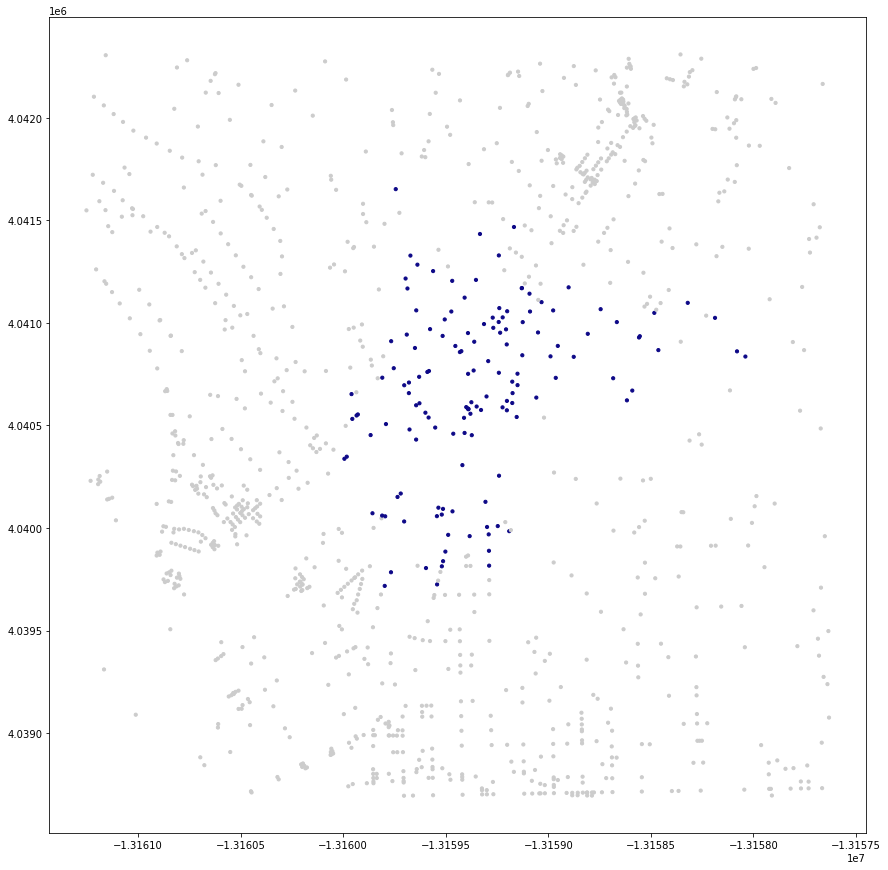

In [227]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

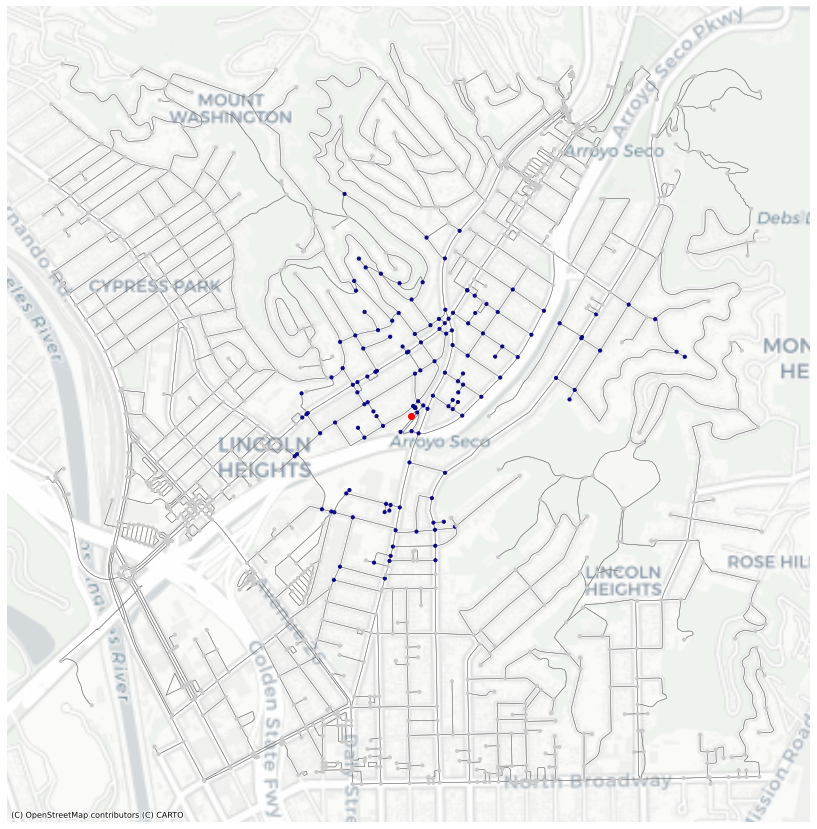

In [228]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[center_node3]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [229]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
14965940,4.040909e+06,-1.315936e+07,NaN,4,-118.212555,34.090114,POINT (-13159361.484 4040908.522),10 mins,#0d0887
1669488556,4.040951e+06,-1.315939e+07,NaN,3,-118.212831,34.090428,POINT (-13159392.130 4040950.824),10 mins,#0d0887
18361081,4.040814e+06,-1.315929e+07,NaN,4,-118.211944,34.089410,POINT (-13159293.389 4040813.959),10 mins,#0d0887
27292003,4.040862e+06,-1.315942e+07,NaN,3,-118.213120,34.089771,POINT (-13159424.323 4040862.484),10 mins,#0d0887
7497608094,4.040976e+06,-1.315927e+07,NaN,3,-118.211721,34.090619,POINT (-13159268.554 4040976.390),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
7428386997,4.040562e+06,-1.315960e+07,NaN,1,-118.214695,34.087539,POINT (-13159599.618 4040562.454),10 mins,#0d0887
7874387046,4.040620e+06,-1.315920e+07,NaN,1,-118.211124,34.087967,POINT (-13159202.119 4040619.930),10 mins,#0d0887
8880638493,4.040737e+06,-1.315963e+07,NaN,3,-118.214969,34.088841,POINT (-13159630.198 4040737.422),10 mins,#0d0887


In [230]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

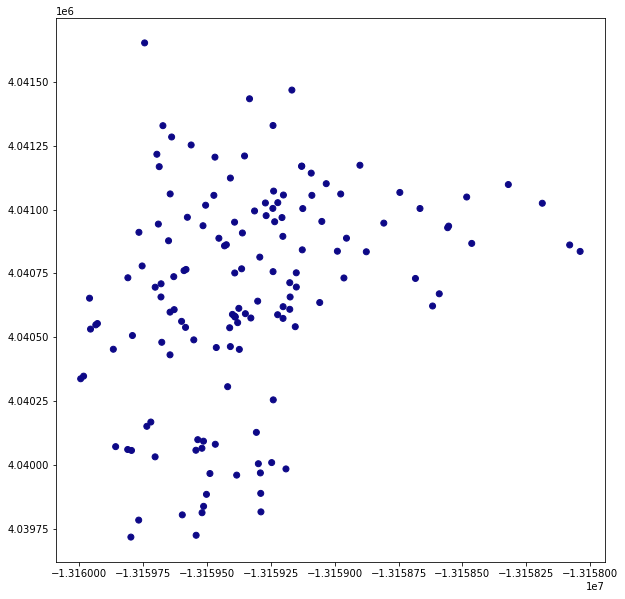

In [231]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

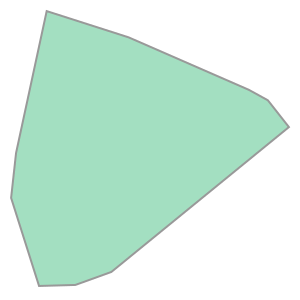

In [232]:
gdf_10.unary_union.convex_hull

In [233]:
# There's our polygon!
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13159994.736 4040337.648, -131599...",4.040909e+06,-1.315936e+07,traffic_signals,4,-118.212555,34.090114,#0d0887


In [234]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13159798.112 4039717.732, -13159994..."


In [235]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13159798.112 4039717.732, -13159994..."


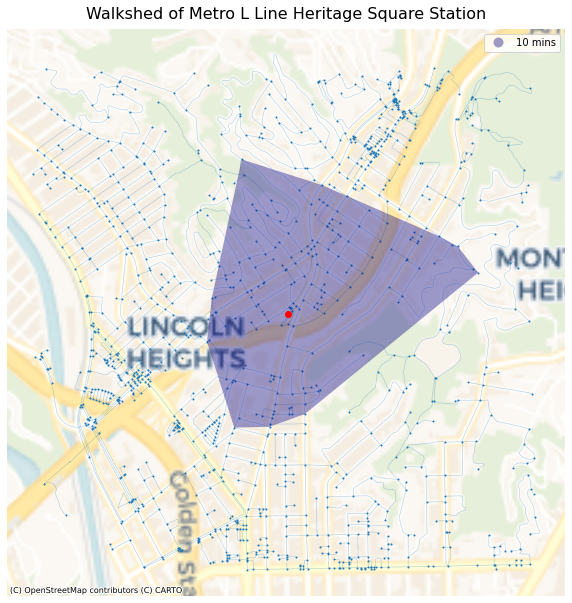

In [236]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node3]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Heritage Square Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=13)

### Highland Park Station

In [250]:
address = 'Highland Park, Marmion Way, Highland Park, Los Angeles, Los Angeles County, California, 90042, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [251]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.48 s, sys: 31.5 ms, total: 3.51 s
Wall time: 17.4 s


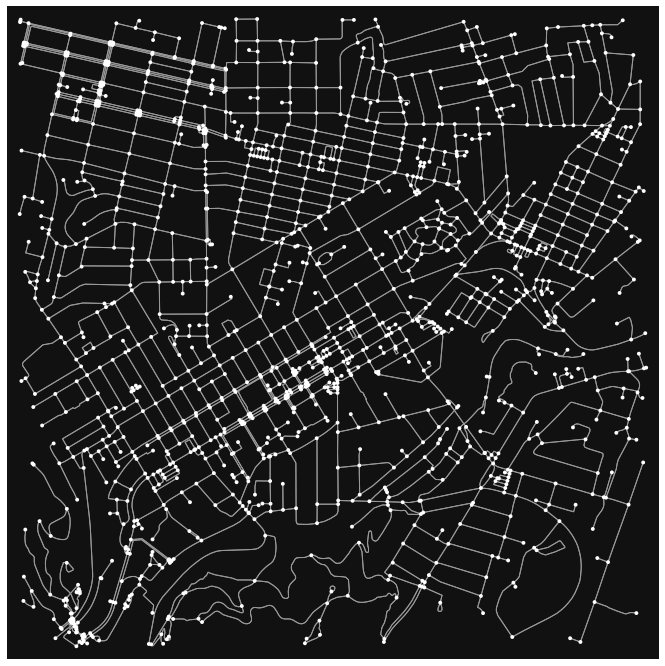

In [252]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [253]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [254]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [255]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
10552905,4.045125e+06,-1.315873e+07,traffic_signals,4,-118.206904,34.121476,POINT (-13158732.406 4045124.904)
14956558,4.045007e+06,-1.315876e+07,stop,4,-118.207144,34.120598,POINT (-13158759.123 4045006.963)
6787557826,4.045178e+06,-1.315872e+07,NaN,3,-118.206794,34.121869,POINT (-13158720.061 4045177.844)
3644839500,4.045123e+06,-1.315872e+07,NaN,4,-118.206818,34.121461,POINT (-13158722.799 4045123.008)
10552907,4.044845e+06,-1.315760e+07,traffic_signals,4,-118.196712,34.119394,POINT (-13157597.793 4044844.985)


### Plotting the station area

<AxesSubplot:>

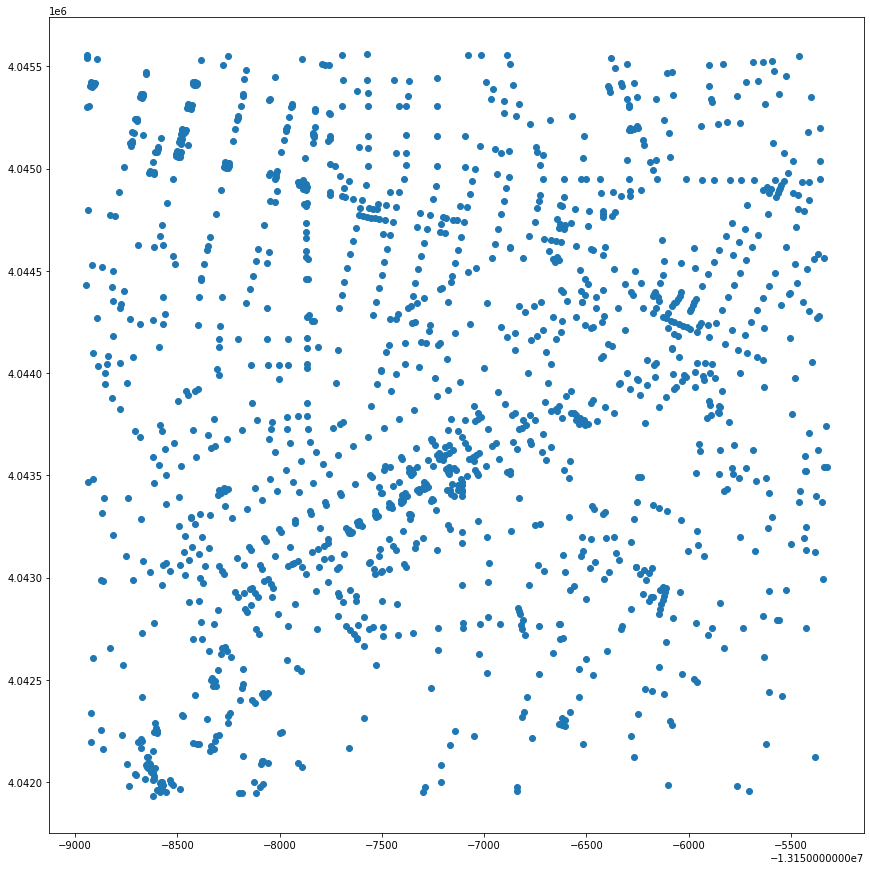

In [256]:
gdf_nodes.plot(figsize=(15,15))

In [257]:
gdf_edges.head()

osmid lanes            name    highway  oneway  \
u        v          key                                                       
10552905 14956558   0     54674043     2       Avenue 50   tertiary   False   
         6787557826 0     54674043     2       Avenue 50   tertiary   False   
         3644839500 0    398616334     5  York Boulevard  secondary   False   
14956558 10553872   0     54674043     2       Avenue 50   tertiary   False   
         10552905   0     54674043     2       Avenue 50   tertiary   False   

                          length  \
u        v          key            
10552905 14956558   0    100.000   
         6787557826 0     44.952   
         3644839500 0      8.097   
14956558 10553872   0    101.501   
         10552905   0    100.000   

                                                                  geometry  \
u        v          key                                                      
10552905 14956558   0    LINESTRING (-13158732.406 4045124.904, -131587...   
         6787557826 0    LINESTRING (-13158732.406 4045124.904, -131587...   
         3644839500 0    LINESTRING (-13158732.406 4045124.904, -131587...   
14956558 10553872   0    LINESTRING (-13158759.123 4045006.963, -131587...   
         10552905   0    LINESTRING (-13158759.123 4045006.963, -131587...   

                        service access bridge maxspeed junction width tunnel  
u        v          key                                                       
10552905 14956558   0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
         6787557826 0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
         3644839500 0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
14956558 10553872   0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
         10552905   0       NaN    NaN    NaN      NaN      NaN   NaN    NaN

<AxesSubplot:>

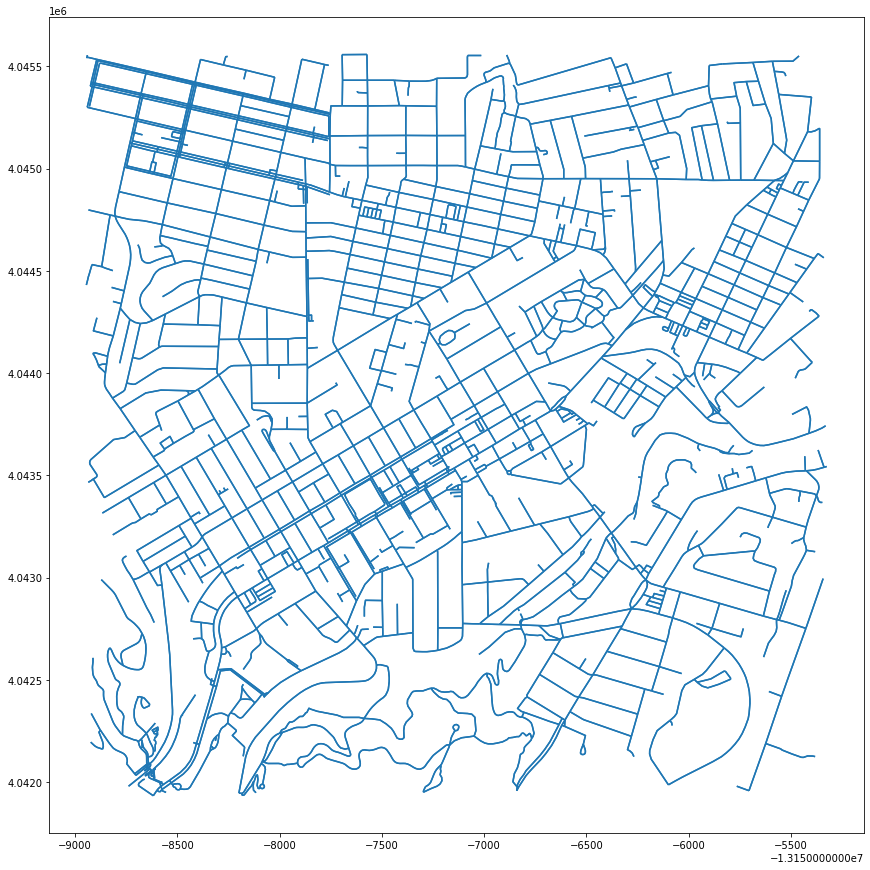

In [258]:
gdf_edges.plot(figsize=(15,15))

In [259]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13158945.382506957
4041933.3467410295
-13155325.361721948
4045557.8058276335


In [260]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13157135.372114453
4043745.5762843313


In [261]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node4 = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node4))

The id for the nearest node is 111964509


In [263]:
# what is this record?
gdf_nodes.loc[[center_node4]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
111964509,4.043716e+06,-1.315713e+07,NaN,3,-118.192502,34.110999,POINT (-13157129.183 4043716.222)


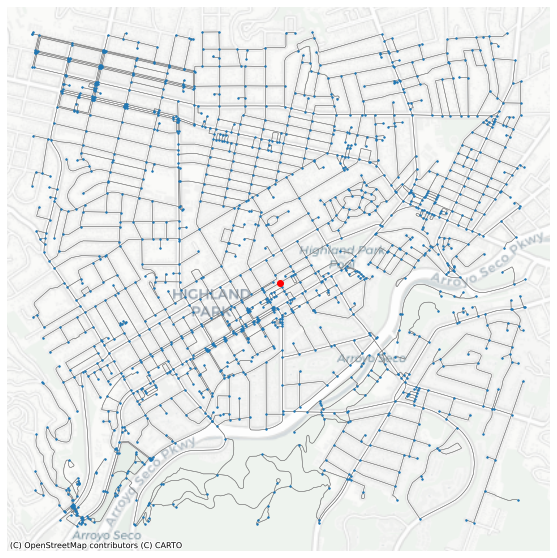

In [264]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node4]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [265]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,service,access,bridge,maxspeed,junction,width,tunnel
u,v,key,,,,,,,,,,,,,,
1621321769,7082459689,0,"[55479168, 535509204]",2,South Avenue 52,tertiary,False,38.579,"LINESTRING (-13157589.288 4042667.468, -131576...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
2384743598,8410829706,0,229938919,NaN,NaN,unclassified,False,17.252,"LINESTRING (-13157534.052 4044756.064, -131575...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
3663175906,2634612707,0,258034403,NaN,NaN,footway,False,10.124,"LINESTRING (-13158486.568 4045068.925, -131584...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
7884165031,8189624762,0,167008825,4,Avenue 50,tertiary,False,53.155,"LINESTRING (-13158774.630 4044339.301, -131587...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
6790478968,601382133,0,406454482,NaN,York Boulevard,secondary,False,12.717,"LINESTRING (-13156113.381 4044267.285, -131561...",NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [266]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [267]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,service,access,bridge,maxspeed,junction,width,tunnel,walk_time
u,v,key,,,,,,,,,,,,,,,
19809066,122526544,0,166902820,NaN,Avenue 54,tertiary,False,48.415,"LINESTRING (-13157852.270 4043664.499, -131578...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.605187
6787643135,6787643134,0,723716130,NaN,NaN,service,False,25.365,"LINESTRING (-13156797.228 4043743.677, -131568...",NaN,customers,NaN,NaN,NaN,NaN,NaN,0.317062
19809040,122810286,0,166902827,NaN,Range View Avenue,residential,False,94.590,"LINESTRING (-13157941.403 4045307.648, -131578...",NaN,NaN,NaN,25 mph,NaN,NaN,NaN,1.182375
5690240374,2634609629,0,258033926,NaN,NaN,footway,False,78.669,"LINESTRING (-13157861.164 4044462.359, -131578...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.983362
7690745881,2482978636,0,240573809,NaN,NaN,footway,False,10.753,"LINESTRING (-13158530.729 4041995.938, -131585...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.134412


In [268]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [269]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [271]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 111964509, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 240 nodes within 10 minutes 


In [272]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
1840753872,4.044691e+06,-1.315787e+07,NaN,3,-118.199172,34.118251,POINT (-13157871.628 4044691.320),NaN,NaN
2863170142,4.043223e+06,-1.315765e+07,NaN,3,-118.197155,34.107328,POINT (-13157647.097 4043222.702),NaN,NaN
6734865605,4.043600e+06,-1.315723e+07,NaN,3,-118.193409,34.110135,POINT (-13157230.060 4043600.070),10 mins,#0d0887
6469159599,4.044575e+06,-1.315578e+07,NaN,3,-118.180409,34.117388,POINT (-13155782.985 4044575.319),NaN,NaN
2634610741,4.045111e+06,-1.315873e+07,NaN,3,-118.206842,34.121374,POINT (-13158725.493 4045111.269),NaN,NaN
3101301111,4.042341e+06,-1.315681e+07,NaN,3,-118.189595,34.100773,POINT (-13156805.488 4042341.377),NaN,NaN
1839530991,4.044951e+06,-1.315643e+07,stop,3,-118.186237,34.120179,POINT (-13156431.710 4044950.594),NaN,NaN
1784125374,4.044298e+06,-1.315680e+07,NaN,3,-118.189551,34.115328,POINT (-13156800.646 4044298.305),10 mins,#0d0887
5690240369,4.043228e+06,-1.315767e+07,NaN,4,-118.197332,34.107364,POINT (-13157666.834 4043227.542),10 mins,#0d0887


In [273]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [274]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
1786861394,4.045432e+06,-1.315769e+07,NaN,3,-118.197564,34.123757,POINT (-13157692.615 4045431.724),NaN,#cccccc
7202940847,4.043951e+06,-1.315669e+07,NaN,1,-118.188531,34.112748,POINT (-13156687.100 4043951.448),10 mins,#0d0887
7361921487,4.044785e+06,-1.315731e+07,NaN,3,-118.194143,34.118948,POINT (-13157311.769 4044785.028),NaN,#cccccc
2863170130,4.043278e+06,-1.315761e+07,NaN,4,-118.196859,34.107741,POINT (-13157614.113 4043278.174),10 mins,#0d0887
6469159600,4.044669e+06,-1.315582e+07,NaN,3,-118.180729,34.118088,POINT (-13155818.630 4044669.349),NaN,#cccccc


<AxesSubplot:>

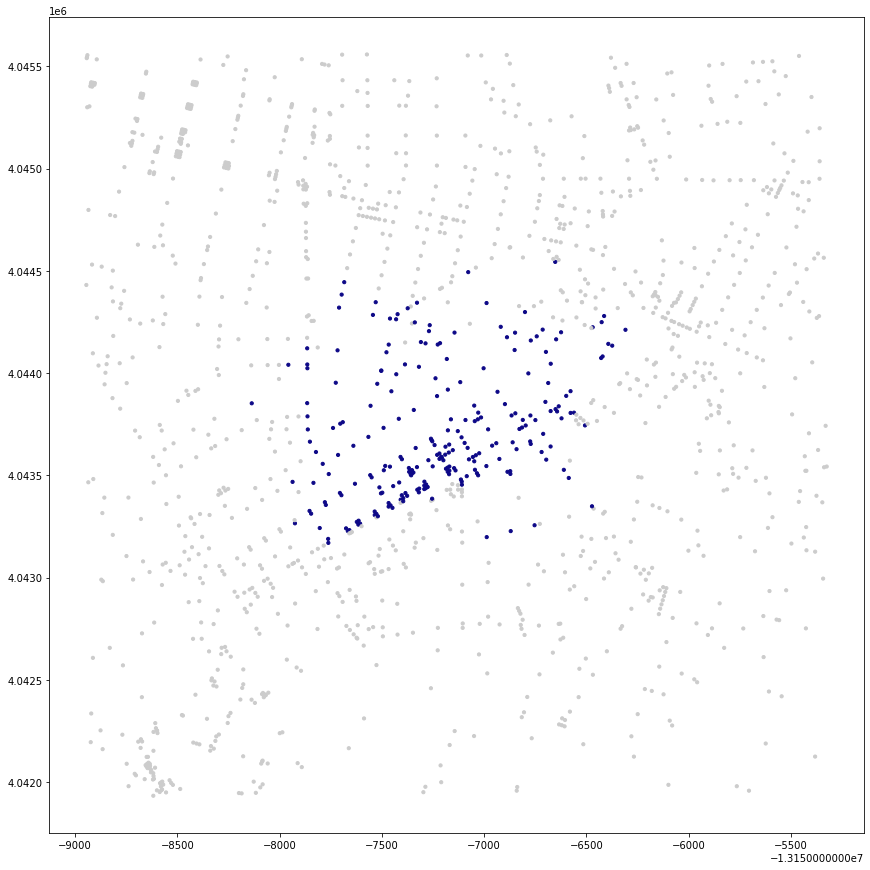

In [275]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

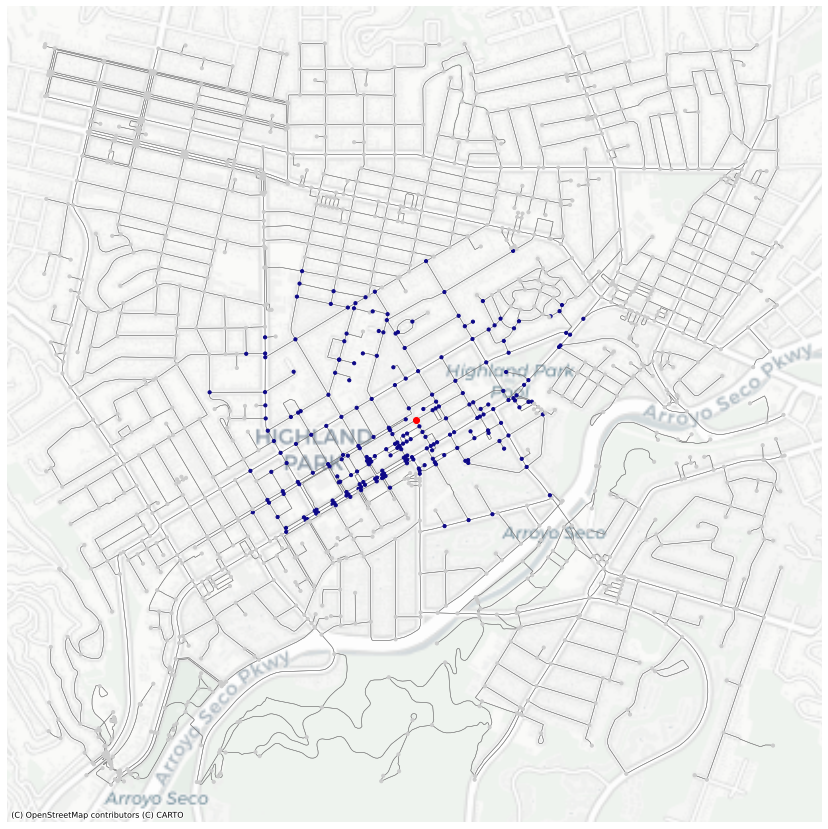

In [276]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[center_node4]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [277]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
18364121,4.044212e+06,-1.315631e+07,NaN,3,-118.185137,34.114683,POINT (-13156309.315 4044211.620),10 mins,#0d0887
19809027,4.043265e+06,-1.315793e+07,NaN,3,-118.199655,34.107645,POINT (-13157925.418 4043265.308),10 mins,#0d0887
14760044,4.043814e+06,-1.315668e+07,traffic_signals,4,-118.188425,34.111728,POINT (-13156675.244 4043814.184),10 mins,#0d0887
702230871,4.043859e+06,-1.315670e+07,NaN,3,-118.188654,34.112062,POINT (-13156700.792 4043859.091),10 mins,#0d0887
6787726293,4.043824e+06,-1.315665e+07,NaN,3,-118.188208,34.111798,POINT (-13156651.143 4043823.650),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8410872932,4.043640e+06,-1.315719e+07,NaN,3,-118.193044,34.110432,POINT (-13157189.440 4043640.029),10 mins,#0d0887
8410872935,4.043651e+06,-1.315717e+07,NaN,3,-118.192880,34.110511,POINT (-13157171.228 4043650.597),10 mins,#0d0887
8459928442,4.043544e+06,-1.315725e+07,NaN,1,-118.193605,34.109716,POINT (-13157251.935 4043543.776),10 mins,#0d0887


In [278]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

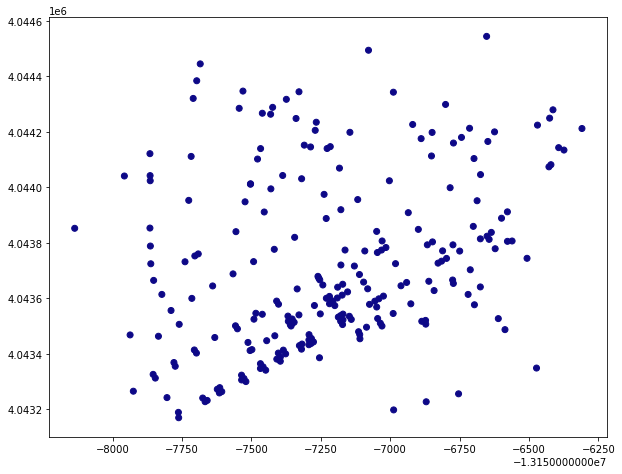

In [279]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

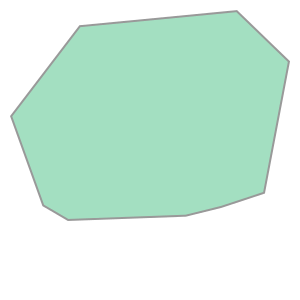

In [280]:
gdf_10.unary_union.convex_hull

In [281]:
# There's our polygon!
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13158136.669 4043852.127, -131579...",4.044212e+06,-1.315631e+07,traffic_signals,3,-118.185137,34.114683,#0d0887


In [282]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13157762.101 4043169.744, -13157925..."


In [283]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13157762.101 4043169.744, -13157925..."


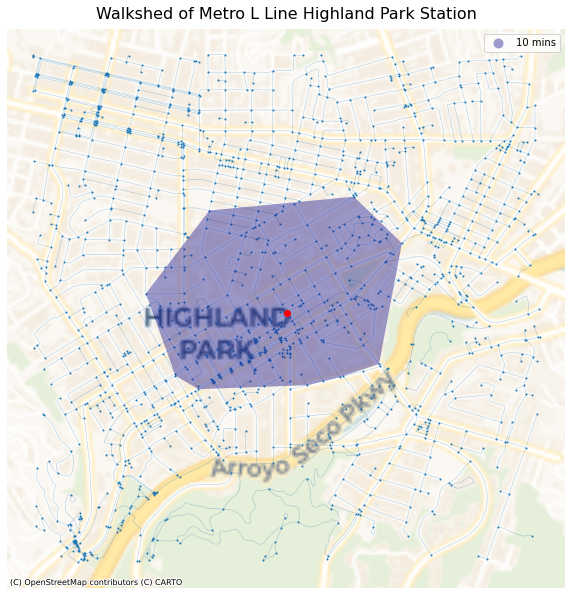

In [297]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node4]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Highland Park Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=13)

### Del Mar Station

In [332]:
# Let's start by orienting ourselves around the Del Mar Station by calling for it by address in osmnx

address = 'Del Mar, South Raymond Avenue, Old Pasadena, Pasadena, Los Angeles County, California, 91105, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [333]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.69 s, sys: 34 ms, total: 3.72 s
Wall time: 3.82 s


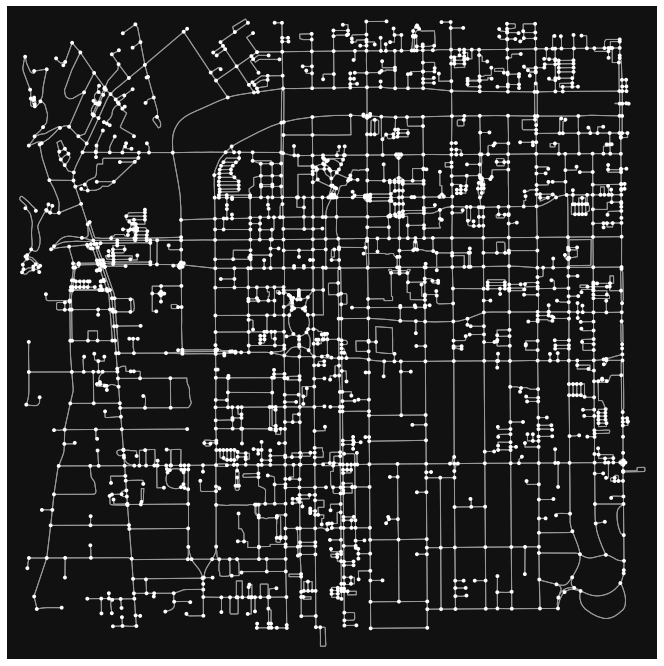

In [334]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [335]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [336]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [337]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
14963716,4.049279e+06,-1.315043e+07,traffic_signals,4,-118.132316,34.152361,POINT (-13150429.308 4049278.739)
6784510760,4.049278e+06,-1.315040e+07,NaN,3,-118.132087,34.152358,POINT (-13150403.793 4049278.403)
3892769467,4.049279e+06,-1.315045e+07,traffic_signals,4,-118.132468,34.152362,POINT (-13150446.139 4049278.941)
1995207967,4.049204e+06,-1.315043e+07,NaN,4,-118.132311,34.151805,POINT (-13150428.729 4049204.015)
6784510757,4.049306e+06,-1.315043e+07,NaN,3,-118.132316,34.152564,POINT (-13150429.308 4049306.141)


<AxesSubplot:>

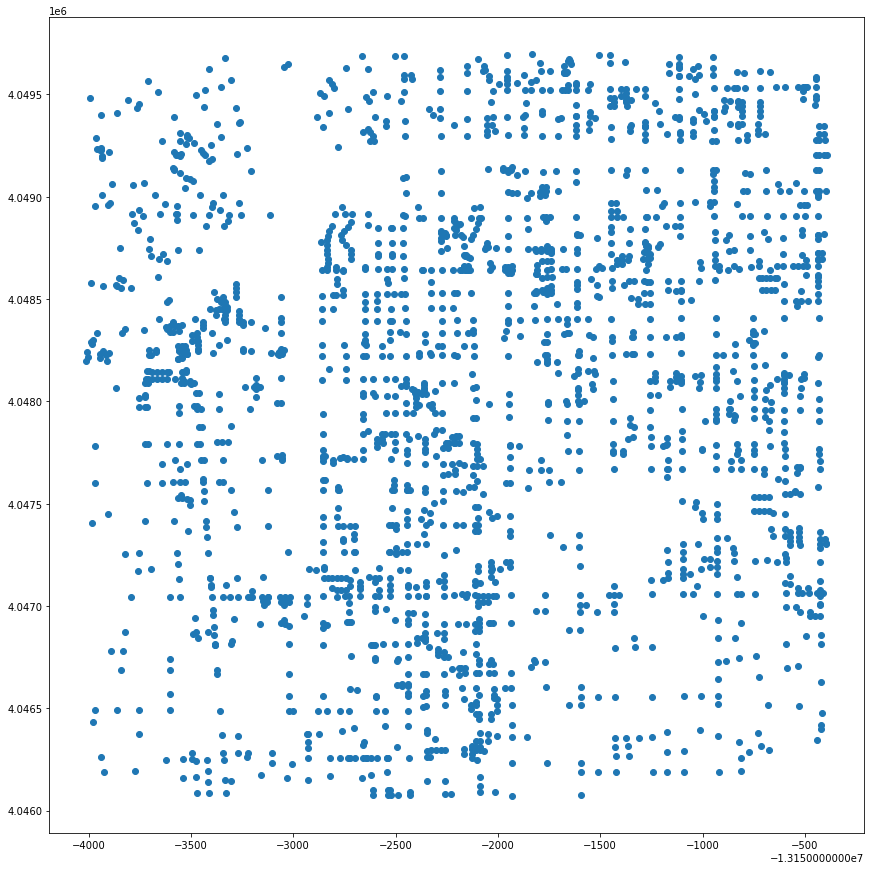

In [338]:
gdf_nodes.plot(figsize=(15,15))

In [339]:
gdf_edges.head()

osmid  oneway               name  \
u          v          key                                                      
14963716   6784510760 0                 405328940   False       Maple Street   
           3892769467 0                 607802969   False       Maple Street   
           1995207967 0    [173415946, 173415947]   False  North Lake Avenue   
           6784510757 0                 385937988   False  North Lake Avenue   
6784510760 14963716   0                 405328940   False       Maple Street   

                             highway  length  \
u          v          key                      
14963716   6784510760 0      primary  21.093   
           3892769467 0      primary  13.914   
           1995207967 0    secondary  61.772   
           6784510757 0    secondary  22.659   
6784510760 14963716   0      primary  21.093   

                                                                    geometry  \
u          v          key                                                      
14963716   6784510760 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           3892769467 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           1995207967 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           6784510757 0    LINESTRING (-13150429.308 4049278.739, -131504...   
6784510760 14963716   0    LINESTRING (-13150403.793 4049278.403, -131504...   

                          maxspeed bridge lanes access service  ref tunnel  \
u          v          key                                                    
14963716   6784510760 0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   
           3892769467 0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   
           1995207967 0     35 mph    yes   NaN    NaN     NaN  NaN    NaN   
           6784510757 0     35 mph    NaN   NaN    NaN     NaN  NaN    NaN   
6784510760 14963716   0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   

                          width  
u          v          key        
14963716   6784510760 0     NaN  
           3892769467 0     NaN  
           1995207967 0     NaN  
           6784510757 0     NaN  
6784510760 14963716   0     NaN

<AxesSubplot:>

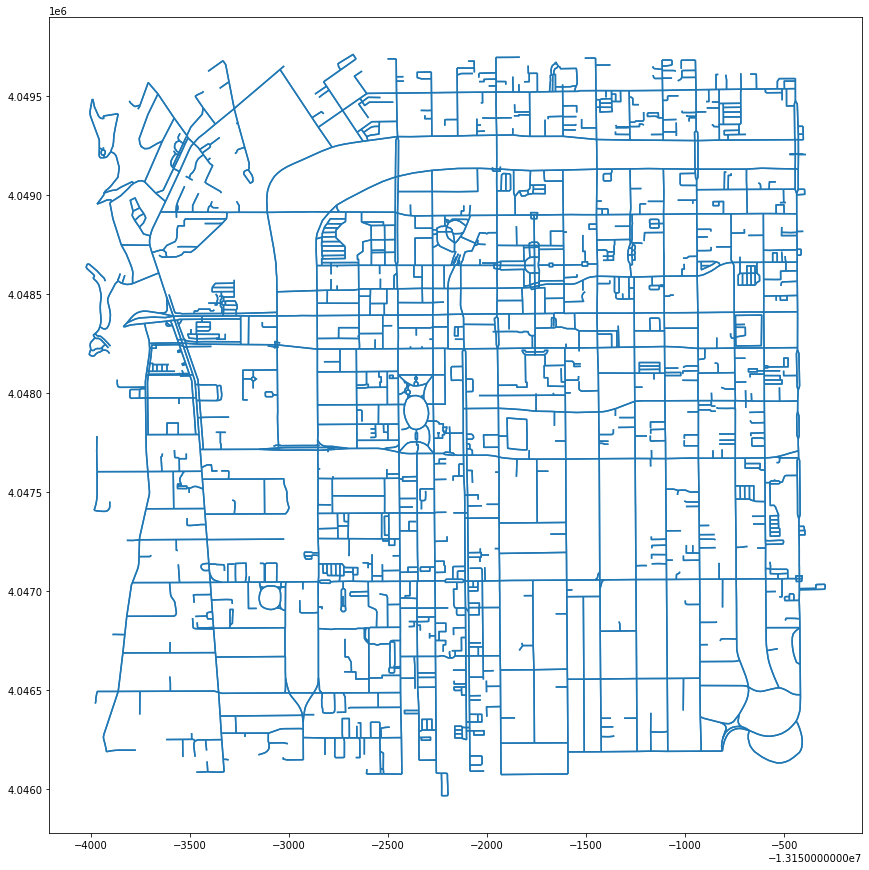

In [340]:
gdf_edges.plot(figsize=(15,15))

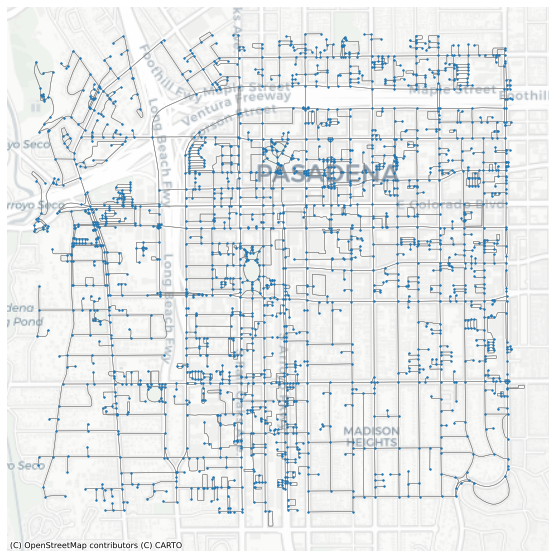

In [341]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)


# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [342]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13154010.901174664
4046072.998110596
-13150391.069632793
4049695.185661036


In [343]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13152200.985403728
4047884.0918858163


In [383]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node6 = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node6))

The id for the nearest node is 5599455859


In [384]:
# what is this record?
gdf_nodes.loc[[center_node6]]

,y,x,street_count,lon,lat,highway,geometry
osmid,,,,,,,
5599455859,4.047971e+06,-1.313891e+07,1,-118.028828,34.142635,NaN,POINT (-13138909.043 4047970.553)


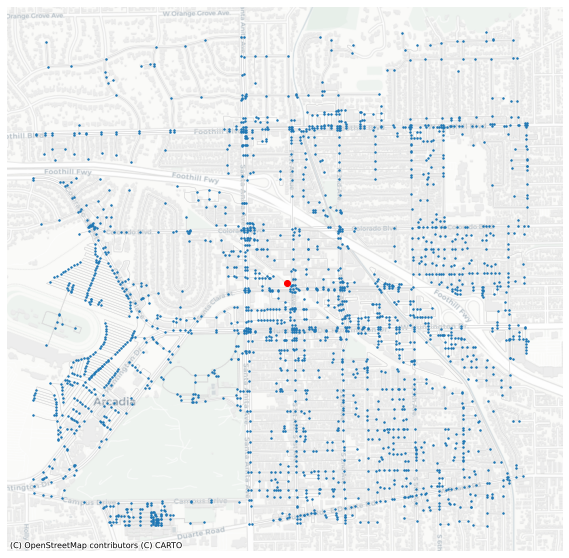

In [385]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gainsboro', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node6]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [349]:
gdf_edges.sample(5)

,,,osmid,oneway,name,highway,length,geometry,maxspeed,bridge,lanes,access,service,ref,tunnel,width
u,v,key,,,,,,,,,,,,,,
5404648268,4367211959,0,439093807,False,NaN,footway,10.530,"LINESTRING (-13152204.531 4048871.791, -131522...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
647079464,647079467,0,50757808,False,NaN,footway,74.556,"LINESTRING (-13152106.670 4048841.835, -131521...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8681711450,8681711448,0,936974333,False,NaN,service,52.123,"LINESTRING (-13152798.699 4049529.455, -131528...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
123416660,123416657,0,971569928,False,Maple Street,primary,82.347,"LINESTRING (-13151952.504 4049301.540, -131520...",NaN,NaN,2,NaN,NaN,NaN,NaN,NaN
6728993285,6728970981,0,203028859,False,South Arroyo Parkway,primary,48.864,"LINESTRING (-13152119.316 4047640.611, -131521...",35 mph,NaN,3,NaN,NaN,NaN,NaN,NaN


In [350]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [351]:
gdf_edges.sample(5)

,,,osmid,oneway,name,highway,length,geometry,maxspeed,bridge,lanes,access,service,ref,tunnel,width,walk_time
u,v,key,,,,,,,,,,,,,,,
29322329,122757974,0,"[405356661, 405356647]",False,East Del Mar Boulevard,secondary,136.741,"LINESTRING (-13150933.930 4047670.161, -131509...",35 mph,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.709262
122809345,122857458,0,13326469,False,Mills Place,service,63.893,"LINESTRING (-13152527.803 4048300.262, -131525...",NaN,NaN,NaN,NaN,alley,NaN,NaN,NaN,0.798663
20827771,6458100490,0,167077296,False,Bellefontaine Street,residential,87.900,"LINESTRING (-13153863.492 4046492.756, -131539...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.098750
5549675178,122830043,0,"[405356786, 405356788]",False,Los Robles Avenue,secondary,37.375,"LINESTRING (-13151450.330 4049481.351, -131514...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.467187
4989832428,122899891,0,185937914,False,South Arroyo Parkway,primary,42.796,"LINESTRING (-13152119.349 4048346.371, -131521...",35 mph,NaN,4,NaN,NaN,NaN,NaN,NaN,0.534950


In [352]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [353]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [354]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 1995241213, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 179 nodes within 10 minutes 


In [355]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
6789802556,4.047094e+06,-1.315244e+07,NaN,3,-118.150383,34.136119,POINT (-13152440.461 4047094.173),NaN,NaN
8395785246,4.049442e+06,-1.315081e+07,NaN,3,-118.135719,34.153571,POINT (-13150808.139 4049441.560),NaN,NaN
1927962653,4.047694e+06,-1.315227e+07,traffic_signals,5,-118.148839,34.140582,POINT (-13152268.595 4047694.451),10 mins,#0d0887
6726250638,4.047884e+06,-1.315135e+07,NaN,1,-118.140614,34.141991,POINT (-13151352.959 4047883.934),NaN,NaN
4367212927,4.048554e+06,-1.315176e+07,crossing,4,-118.144269,34.146975,POINT (-13151759.832 4048554.279),NaN,NaN
5549675178,4.049481e+06,-1.315145e+07,NaN,3,-118.141488,34.153867,POINT (-13151450.330 4049481.351),NaN,NaN
3893865880,4.049221e+06,-1.315358e+07,NaN,1,-118.160658,34.151930,POINT (-13153584.258 4049220.789),NaN,NaN
123155361,4.047051e+06,-1.315226e+07,traffic_signals,4,-118.148796,34.135796,POINT (-13152263.842 4047050.786),NaN,NaN
6731701073,4.047562e+06,-1.315227e+07,NaN,3,-118.148829,34.139601,POINT (-13152267.449 4047562.441),10 mins,#0d0887


In [356]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [357]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
123155361,4.047051e+06,-1.315226e+07,traffic_signals,4,-118.148796,34.135796,POINT (-13152263.842 4047050.786),NaN,#cccccc
6726060266,4.049115e+06,-1.315079e+07,NaN,1,-118.135585,34.151147,POINT (-13150793.178 4049115.477),NaN,#cccccc
5547461869,4.049075e+06,-1.315349e+07,NaN,1,-118.159789,34.150848,POINT (-13153487.510 4049075.284),NaN,#cccccc
3053017470,4.048880e+06,-1.315176e+07,crossing,4,-118.144302,34.149396,POINT (-13151763.583 4048879.943),NaN,#cccccc
1687115121,4.049131e+06,-1.315195e+07,traffic_signals,4,-118.145996,34.151263,POINT (-13151952.114 4049131.054),NaN,#cccccc


<AxesSubplot:>

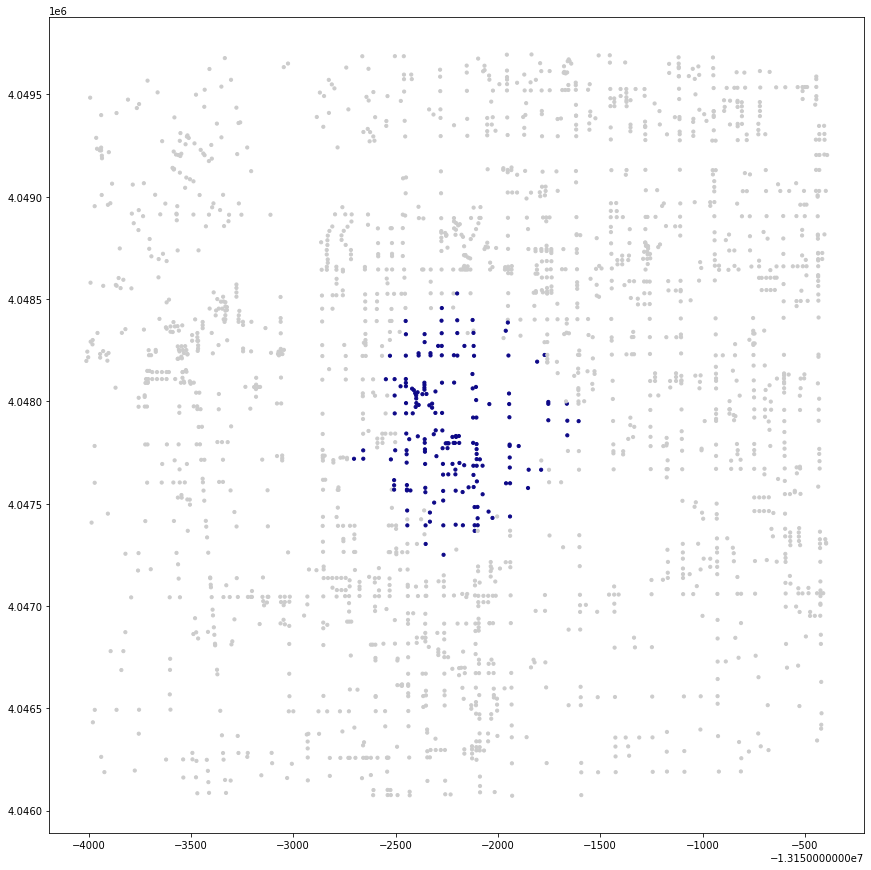

In [358]:
#plotting and taking a look at my nodes within the walkshed
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

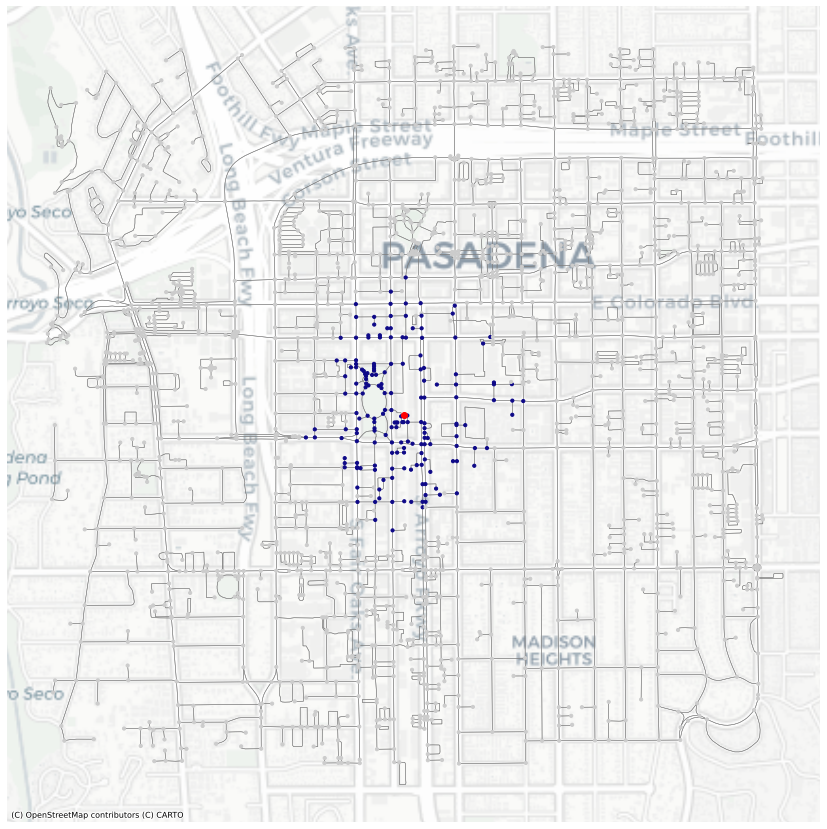

In [359]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[1995241213]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [360]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
16218739,4.048393e+06,-1.315245e+07,traffic_signals,4,-118.150475,34.145775,POINT (-13152450.736 4048392.897),10 mins,#0d0887
122575436,4.048394e+06,-1.315228e+07,traffic_signals,4,-118.148901,34.145787,POINT (-13152275.453 4048394.443),10 mins,#0d0887
122615775,4.048328e+06,-1.315245e+07,NaN,3,-118.150464,34.145293,POINT (-13152449.467 4048328.011),10 mins,#0d0887
29322322,4.047716e+06,-1.315252e+07,NaN,3,-118.151123,34.140746,POINT (-13152522.860 4047716.495),10 mins,#0d0887
725857496,4.047742e+06,-1.315245e+07,NaN,3,-118.150433,34.140933,POINT (-13152446.005 4047741.674),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8366502777,4.047717e+06,-1.315209e+07,NaN,3,-118.147218,34.140748,POINT (-13152088.124 4047716.737),10 mins,#0d0887
8366502785,4.047743e+06,-1.315210e+07,NaN,3,-118.147359,34.140944,POINT (-13152103.865 4047743.113),10 mins,#0d0887
8366502796,4.047767e+06,-1.315210e+07,NaN,3,-118.147361,34.141119,POINT (-13152104.009 4047766.677),10 mins,#0d0887


In [361]:
#creating a new variable for 10 mins nodes
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

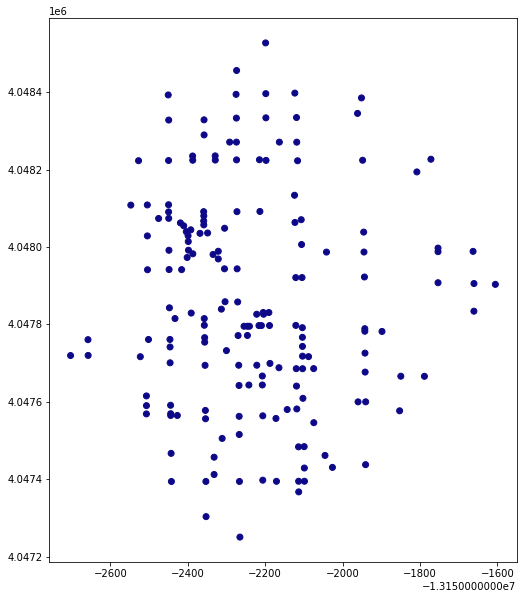

In [362]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

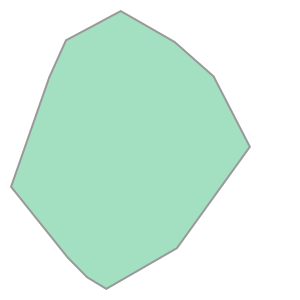

In [363]:
#creating our convex hull
gdf_10.unary_union.convex_hull

In [364]:
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13152703.098 4047719.535, -131526...",4.048393e+06,-1.315245e+07,traffic_signals,4,-118.150475,34.145775,#0d0887


In [365]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13152265.489 4047250.399, -13152352..."


In [366]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13152265.489 4047250.399, -13152352..."


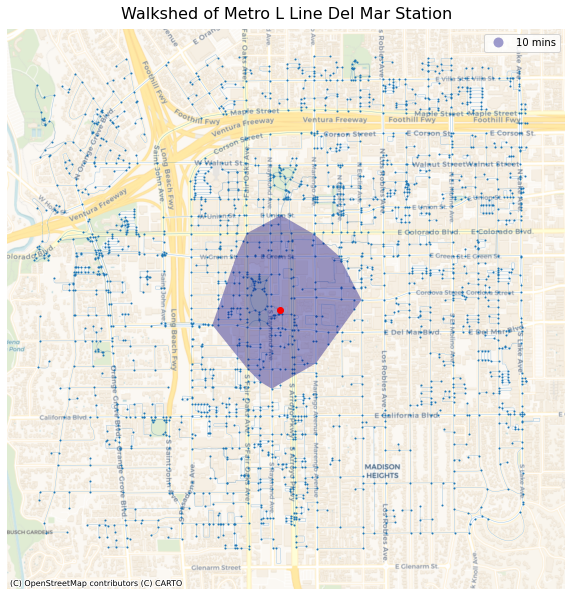

In [367]:
#plotting the convex hull on to the basemap

# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node6]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Del Mar Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

### Arcadia Station

In [2]:
address = 'Arcadia, East Saint Joseph Street, Arcadia, Los Angeles County, California, 91006, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [3]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G7 = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.26 s, sys: 92.1 ms, total: 3.35 s
Wall time: 3.52 s


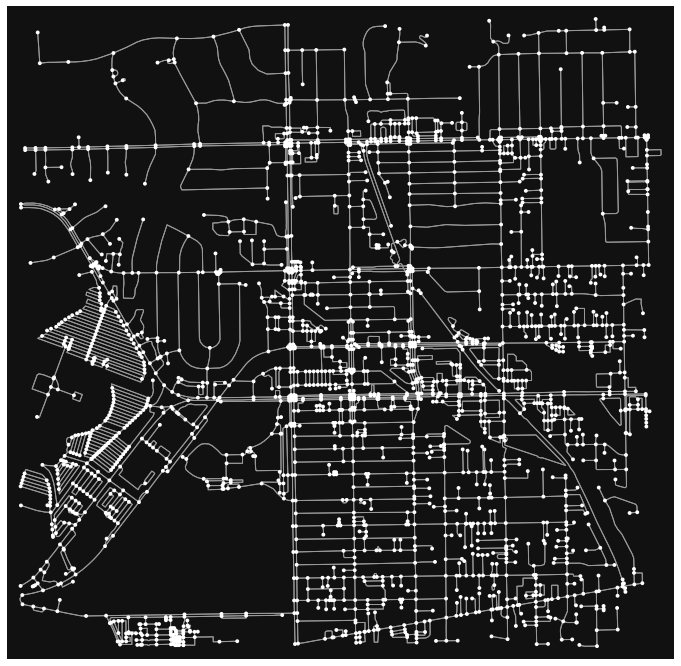

In [4]:
fig, ax = ox.plot_graph(G7,figsize=(12,12))

In [5]:
G7 = ox.project_graph(G7, to_crs='epsg:3857')

In [6]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G7)

In [7]:
gdf_nodes.head()

,y,x,street_count,lon,lat,highway,geometry
osmid,,,,,,,
28947780,4.048216e+06,-1.313920e+07,3,-118.031451,34.144457,NaN,POINT (-13139201.067 4048215.578)
7464757602,4.048249e+06,-1.313920e+07,3,-118.031456,34.144706,NaN,POINT (-13139201.568 4048249.096)
268161590,4.048088e+06,-1.313920e+07,3,-118.031432,34.143510,NaN,POINT (-13139198.930 4048088.256)
122699116,4.048217e+06,-1.313913e+07,3,-118.030834,34.144465,NaN,POINT (-13139132.372 4048216.627)
28947781,4.048357e+06,-1.313920e+07,4,-118.031471,34.145510,traffic_signals,POINT (-13139203.238 4048357.185)


### Plotting the station area

<AxesSubplot:>

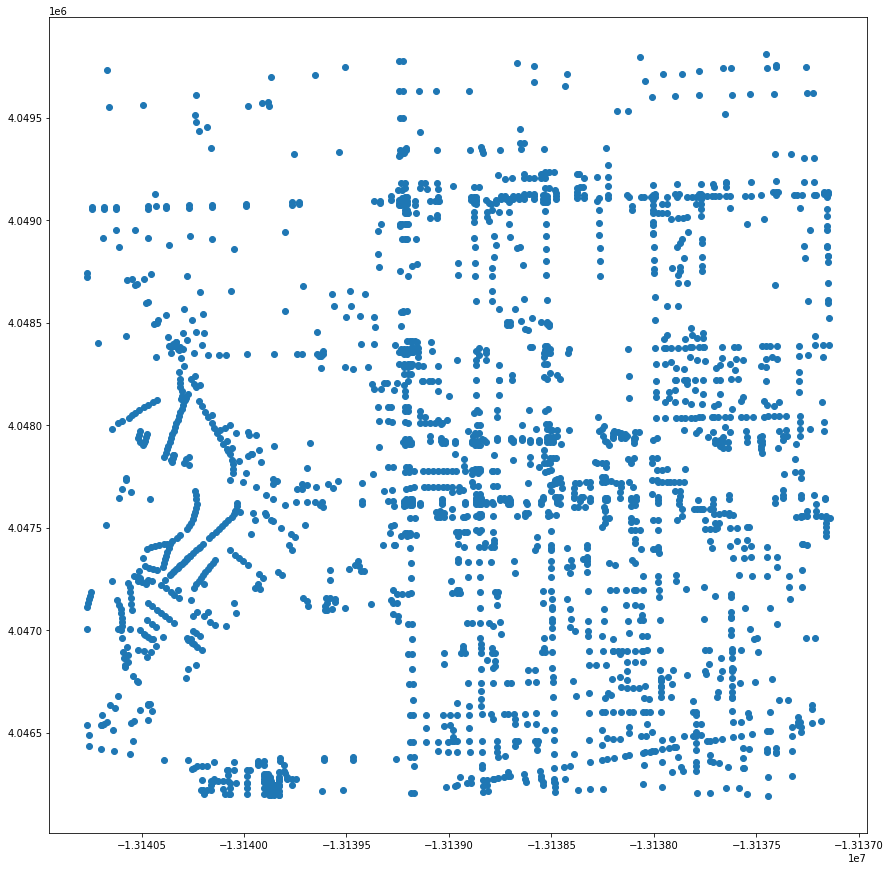

In [8]:
gdf_nodes.plot(figsize=(15,15))

In [9]:
gdf_edges.head()

osmid  oneway lanes                name  \
u          v          key                                                
28947780   7464757602 0    182043866   False     2  Santa Anita Avenue   
           268161590  0    182043866   False     2  Santa Anita Avenue   
           122699116  0    206911853   False   NaN     La Porte Street   
7464757602 939854546  0    182043866   False     2  Santa Anita Avenue   
           28947780   0    182043866   False     2  Santa Anita Avenue   

                               highway   length  \
u          v          key                         
28947780   7464757602 0        primary   27.713   
           268161590  0        primary  105.272   
           122699116  0    residential   56.797   
7464757602 939854546  0        primary   30.260   
           28947780   0        primary   27.713   

                                                                    geometry  \
u          v          key                                                      
28947780   7464757602 0    LINESTRING (-13139201.067 4048215.578, -131392...   
           268161590  0    LINESTRING (-13139201.067 4048215.578, -131391...   
           122699116  0    LINESTRING (-13139201.067 4048215.578, -131391...   
7464757602 939854546  0    LINESTRING (-13139201.568 4048249.096, -131392...   
           28947780   0    LINESTRING (-13139201.568 4048249.096, -131392...   

                          service maxspeed access width bridge tunnel  
u          v          key                                              
28947780   7464757602 0       NaN      NaN    NaN   NaN    NaN    NaN  
           268161590  0       NaN      NaN    NaN   NaN    NaN    NaN  
           122699116  0       NaN      NaN    NaN   NaN    NaN    NaN  
7464757602 939854546  0       NaN      NaN    NaN   NaN    NaN    NaN  
           28947780   0       NaN      NaN    NaN   NaN    NaN    NaN

<AxesSubplot:>

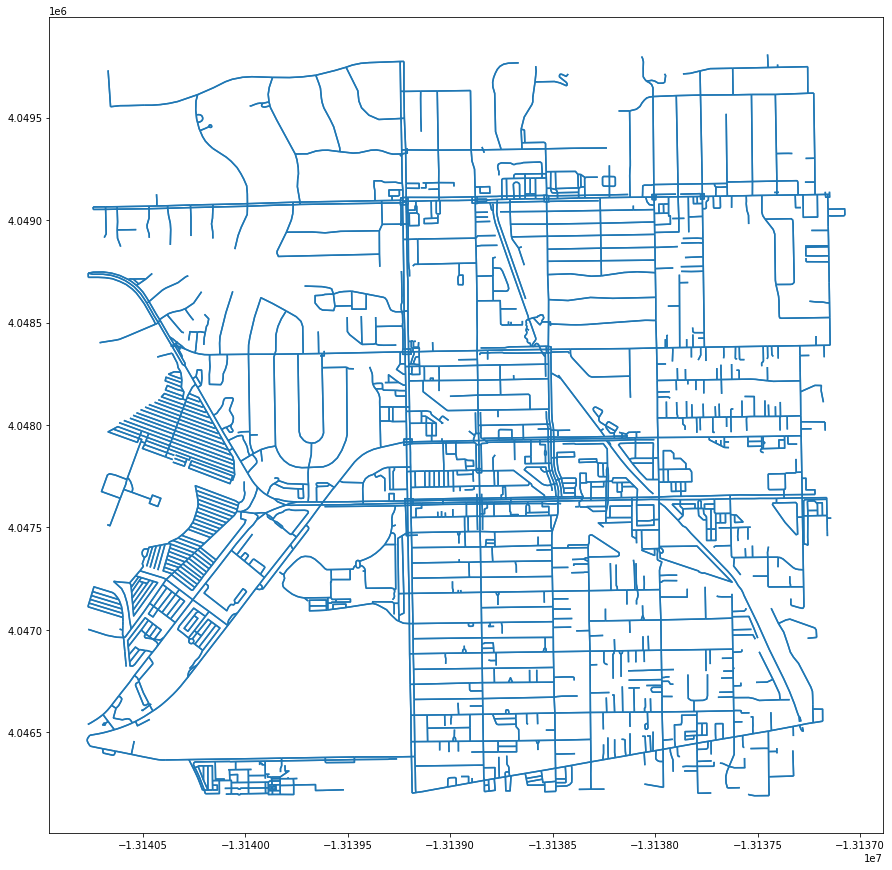

In [10]:
gdf_edges.plot(figsize=(15,15))

In [11]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13140768.523793029
4046191.6095434465
-13137140.766303413
4049808.4405088546


In [12]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13138954.64504822
4048000.0250261505


In [13]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node7 = ox.distance.nearest_nodes(G7,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node7))

The id for the nearest node is 5599455859


In [14]:
# what is this record?
gdf_nodes.loc[[center_node7]]

,y,x,street_count,lon,lat,highway,geometry
osmid,,,,,,,
5599455859,4.047971e+06,-1.313891e+07,1,-118.028828,34.142635,NaN,POINT (-13138909.043 4047970.553)


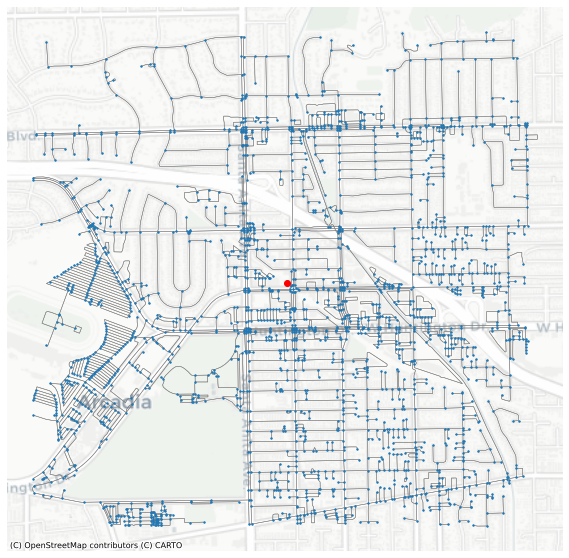

In [15]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node7]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [16]:
gdf_edges.sample(5)

,,,osmid,oneway,lanes,name,highway,length,geometry,service,maxspeed,access,width,bridge,tunnel
u,v,key,,,,,,,,,,,,,
6978525134,6978525121,0,745518065,False,NaN,NaN,footway,6.490,"LINESTRING (-13139862.417 4046223.939, -131398...",NaN,NaN,NaN,NaN,NaN,NaN
2169769017,2169769021,0,206912724,False,NaN,NaN,service,28.188,"LINESTRING (-13139140.398 4048008.711, -131391...",driveway,NaN,NaN,NaN,NaN,NaN
8460109227,6790104168,0,13467844,False,NaN,Bonita Street,residential,45.542,"LINESTRING (-13137558.326 4047353.758, -131376...",NaN,NaN,NaN,NaN,NaN,NaN
7059565429,322079583,0,1018517762,False,3,Huntington Drive,primary,9.517,"LINESTRING (-13138240.436 4047632.474, -131382...",NaN,30 mph,NaN,NaN,NaN,NaN
6731675513,6819622012,0,13372985,False,NaN,California Street,residential,182.354,"LINESTRING (-13138762.246 4047184.968, -131385...",NaN,NaN,NaN,NaN,NaN,NaN


In [17]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [18]:
gdf_edges.sample(5)

,,,osmid,oneway,lanes,name,highway,length,geometry,service,maxspeed,access,width,bridge,tunnel,walk_time
u,v,key,,,,,,,,,,,,,,
6819494924,6789907328,0,80560784,False,NaN,NaN,service,26.741,"LINESTRING (-13138951.901 4047700.355, -131389...",alley,NaN,NaN,NaN,NaN,NaN,0.334263
7215957564,7215957580,0,772867506,False,NaN,NaN,service,11.431,"LINESTRING (-13140303.130 4048140.363, -131403...",NaN,NaN,NaN,NaN,NaN,NaN,0.142888
7111595196,6134797501,0,654696060,False,NaN,NaN,service,18.778,"LINESTRING (-13140358.211 4047187.120, -131403...",parking_aisle,NaN,NaN,NaN,NaN,NaN,0.234725
7129312414,7129312415,0,762954594,False,NaN,NaN,service,150.064,"LINESTRING (-13140230.706 4047615.568, -131400...",parking_aisle,NaN,NaN,NaN,NaN,NaN,1.875800
6978511183,6978557800,0,745520908,False,NaN,NaN,footway,5.551,"LINESTRING (-13139791.361 4046274.168, -131397...",NaN,NaN,NaN,NaN,NaN,NaN,0.069388


In [19]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [20]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [21]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G7, 5599455859, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 165 nodes within 10 minutes 


In [22]:
gdf_nodes.sample(30)

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
6978518278,4.046380e+06,-1.313947e+07,3,-118.033847,34.130809,NaN,POINT (-13139467.711 4046380.046),NaN,NaN
7663420789,4.047981e+06,-1.313729e+07,3,-118.014266,34.142712,NaN,POINT (-13137287.964 4047980.856),NaN,NaN
6994336131,4.049034e+06,-1.313796e+07,3,-118.020289,34.150538,NaN,POINT (-13137958.486 4049033.571),NaN,NaN
7874787652,4.048568e+06,-1.314029e+07,3,-118.041271,34.147075,NaN,POINT (-13140294.191 4048567.730),NaN,NaN
7129317268,4.047403e+06,-1.314022e+07,3,-118.040606,34.138413,NaN,POINT (-13140220.108 4047402.647),NaN,NaN
8451774123,4.046697e+06,-1.313797e+07,3,-118.020363,34.133162,NaN,POINT (-13137966.690 4046696.502),NaN,NaN
6094647099,4.047699e+06,-1.313816e+07,3,-118.022110,34.140619,NaN,POINT (-13138161.232 4047699.414),NaN,NaN
6094647150,4.047568e+06,-1.313770e+07,3,-118.018009,34.139643,NaN,POINT (-13137704.633 4047568.158),NaN,NaN
122960160,4.047779e+06,-1.313886e+07,4,-118.028377,34.141211,traffic_signals,POINT (-13138858.827 4047779.024),10 mins,#0d0887


In [23]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [24]:
gdf_nodes.sample(5)

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
7215948455,4.047817e+06,-1.314029e+07,3,-118.041243,34.141497,NaN,POINT (-13140291.052 4047817.477),NaN,#cccccc
122615019,4.046896e+06,-1.313832e+07,4,-118.023518,34.134647,NaN,POINT (-13138317.881 4046896.243),NaN,#cccccc
6734690533,4.047928e+06,-1.313869e+07,3,-118.026829,34.142316,NaN,POINT (-13138686.471 4047927.580),10 mins,#0d0887
7144764492,4.046608e+06,-1.314051e+07,1,-118.043189,34.132507,NaN,POINT (-13140507.647 4046608.346),NaN,#cccccc
6726355025,4.048104e+06,-1.313777e+07,1,-118.018562,34.143630,NaN,POINT (-13137766.204 4048104.397),NaN,#cccccc


<AxesSubplot:>

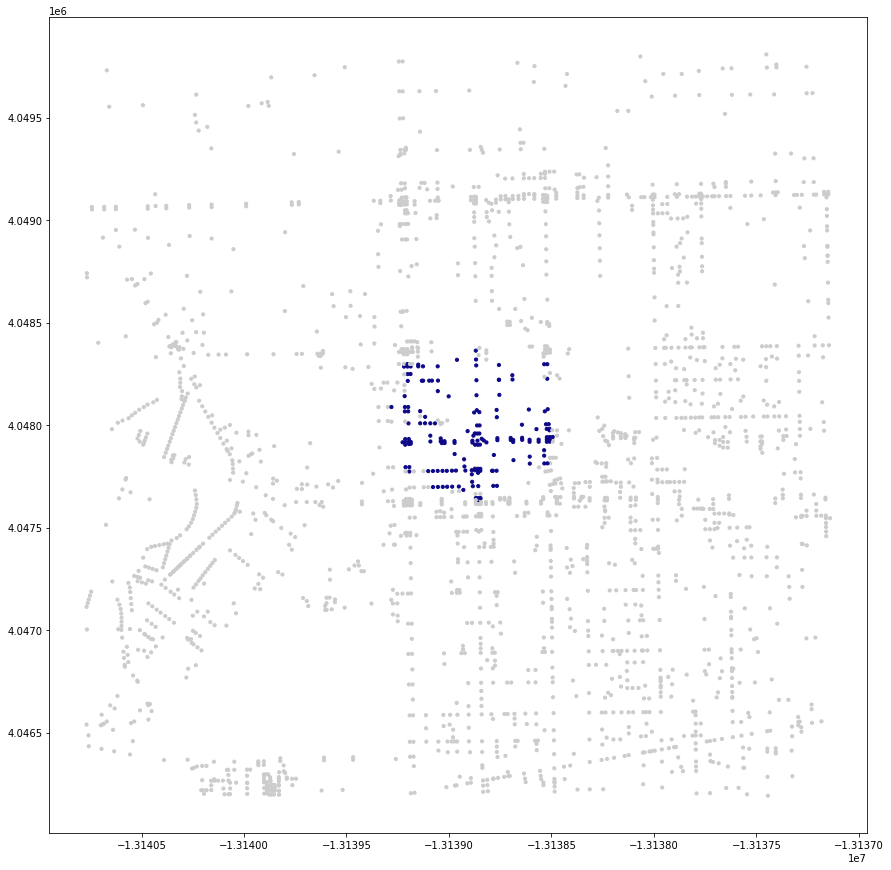

In [25]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

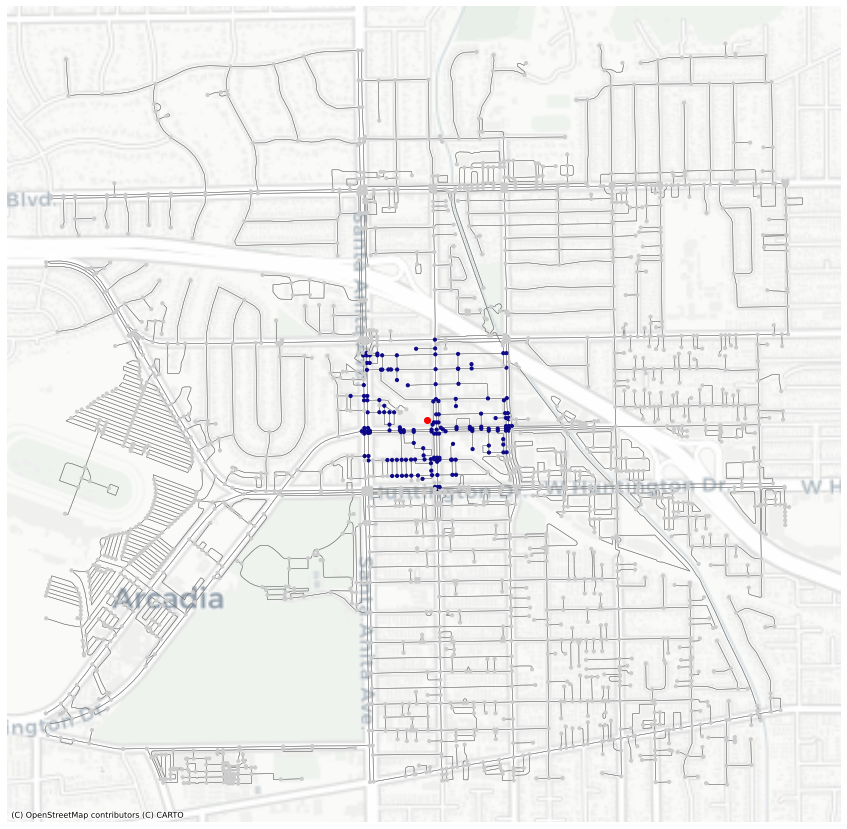

In [26]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[center_node7]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [27]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
28947780,4.048216e+06,-1.313920e+07,3,-118.031451,34.144457,NaN,POINT (-13139201.067 4048215.578),10 mins,#0d0887
7464757602,4.048249e+06,-1.313920e+07,3,-118.031456,34.144706,NaN,POINT (-13139201.568 4048249.096),10 mins,#0d0887
268161590,4.048088e+06,-1.313920e+07,3,-118.031432,34.143510,NaN,POINT (-13139198.930 4048088.256),10 mins,#0d0887
122699116,4.048217e+06,-1.313913e+07,3,-118.030834,34.144465,NaN,POINT (-13139132.372 4048216.627),10 mins,#0d0887
7883463556,4.048217e+06,-1.313913e+07,3,-118.030777,34.144465,NaN,POINT (-13139126.005 4048216.681),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
7464904760,4.048067e+06,-1.313853e+07,1,-118.025445,34.143353,NaN,POINT (-13138532.405 4048067.126),10 mins,#0d0887
7464904766,4.048063e+06,-1.313885e+07,1,-118.028313,34.143324,NaN,POINT (-13138851.758 4048063.158),10 mins,#0d0887
7874784811,4.048319e+06,-1.313896e+07,1,-118.029295,34.145223,NaN,POINT (-13138961.029 4048318.595),10 mins,#0d0887


In [28]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

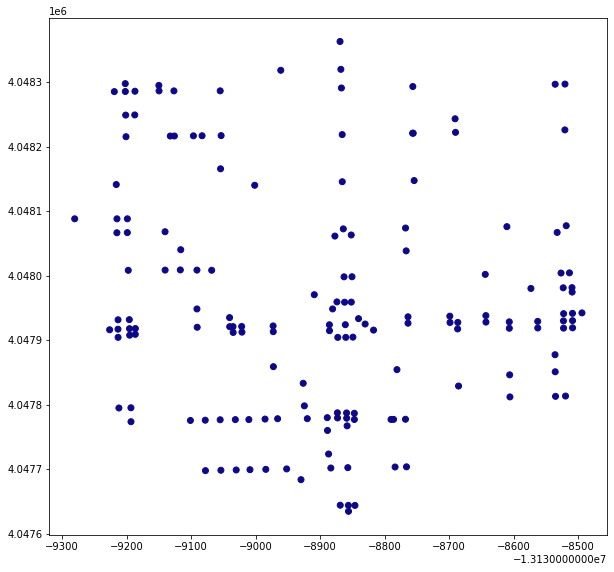

In [29]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

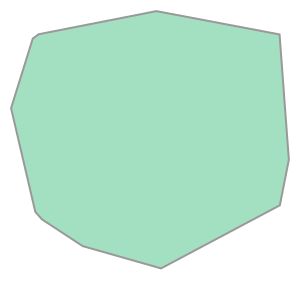

In [30]:
gdf_10.unary_union.convex_hull

In [31]:
# There's our polygon!
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,street_count,lon,lat,highway,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13139280.639 4048088.229, -131392...",4.048216e+06,-1.313920e+07,3,-118.031451,34.144457,traffic_signals,#0d0887


In [32]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13138855.977 4047634.613, -13139077..."


In [33]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13138855.977 4047634.613, -13139077..."


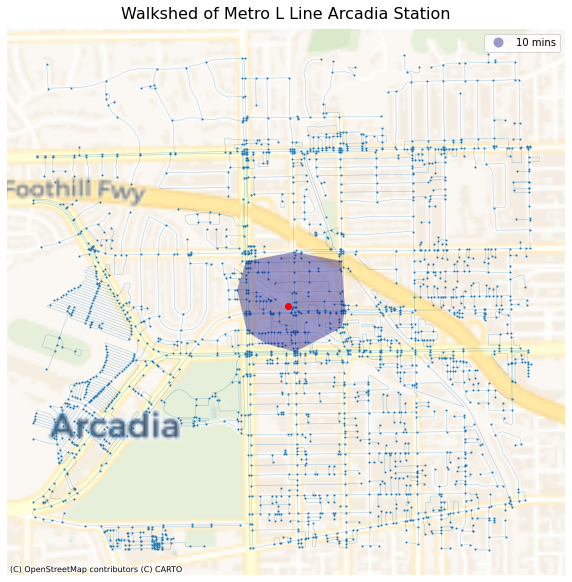

In [34]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node7]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Arcadia Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=13)